<a href="https://colab.research.google.com/github/s273871/ImSecu/blob/main/BiometricChallenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Biometric challenge: Can you make your way into Cannes Festival?**

**Spring 2021, 
Course: Imaging for Security Applications**

**J.-L. Dugelay, K. Mallat, N. Mirabet-Herranz**

**Student(s) name: Paolo D'Ambrosio**


Welcome to Côte d'Azur! 
As you may know, one of the most important events of the region is the well known *Cannes Film Festival*. You want to have access to it to meet the most popular celebrities of the decade but there is a problem, the festival is secured with a face biometrics system!

As an Eurecom student you have access to some imaging security knowledge and it appears to be in your possesion the face recognition system that is being used. Your objective is to evaluate the system to know more about how it operates and to adapt a  “hacking” technique to it.


**General instructions**

- Answer the questions precisely. Remember you should provide your comments and justifications for each step of the challenge. You will find a text cell after each question with **"Your answer"** marked.

- Send the complete notebook with your answers (in English) before **March 31st**. 

- Remember to indicate your name & surname at the beginning of the notebook.

-  The code of the notebook has to run. If it presents compilation errors the student will be asked to submit a new running version.

**Challenge description**

- This challenge will focus on face recognition and morphing. We will work with a pre-trained Vgg-Face model architecture, the dlib cnn face detector and a face morphing function.

- We will work with a self-collected Eurecom database consisting of 400 images of 20 individuals (different gender, age and ethnicity). Each image has a different size and there are variations in illumination, pose, facial expressions…

- The name of face images is of the form: name_??.jpg where "name" is  the surname of the subject and ?? a number between #1 and #20 that identifies each variation of the same individual. *Example: murphy_01.jpg / aniston_15.jpg*

# **0. Setting up the lab**

### **0.1. Installation (conda, environment)**

In [1]:
!which conda

/usr/local/bin/conda


If it is not installed, let's do it together!


In [2]:
# try to install miniconda
conda_path = ''
try:
    conda_path = !which conda
finally:
    print('')

if (len(conda_path) == 0):
    print('installing miniconda')
    !wget https://repo.continuum.io/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh && bash Miniconda3-4.5.4-Linux-x86_64.sh -bfp /usr/local
    !conda update conda -y -q
    !source /usr/local/etc/profile.d/conda.sh
    !conda init 
    !conda install -n root _license -y -q
else:
    print('found miniconda')


found miniconda


Let's check if it was correctly installed.

In [3]:
!which conda

/usr/local/bin/conda


Now, let's set up a conda environment for our mission. We need to create a new environment, let's call it "BiometricChallenge". Then, we need to install the packages we will be needing.

In [4]:
conda_envs = !conda env list
res = [i for i in conda_envs if 'BiometricChallenge' in i]
if (len(res) == 0):
    print('not found BiometricChallenge env', len(res))
    !conda create -y -q --name BiometricChallenge python=3.6 tensorflow
else:
    print('found BiometricChallenge env', len(res))

found BiometricChallenge env 1


In [5]:
%%bash
conda env list
source activate BiometricChallenge


# conda environments:
#
base                  *  /usr/local
BiometricChallenge       /usr/local/envs/BiometricChallenge



To enable GPU, go to the Toolbar > RunTime > Change runtime type > Set Hardware Accelerator > GPU

### **0.2. Data preparation**



1.   Download the 'BiometricChallenge.zip' file from moodle and extract it.  In this compressed fodler, may find the weights of the pretrained models that you need for this challenge, and the data that you need to evaluate the face recognition system used by the Cannes Festival.
2.   Upload the extracted folder 'BiometricChallenge' to your Google Drive under >MyDrive.
3.   Mount yout Google Drive by running the following cell and following the steps that are proposed.


In [6]:
from google.colab import drive

drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


Verify that your Google drive was mounted correctly, and that the data is in the right path.

In [7]:
!ls /gdrive/MyDrive/BiometricChallenge/


face_classifier_model_cannes_array_new.h5
mmod_human_face_detector.dat
morph.py
Paolo.jpeg
__pycache__
shape_predictor_68_face_landmarks.dat
testset
vgg_face_weights.h5


# **1. Verification of a Face Classifier**



A facial recognition system is a technology capable of matching a human face from a digital image or a video frame against a database of faces, typically employed to authenticate users through ID verification services. It works by pinpointing and measuring facial features from a given image.

In this challenge, face recognition is achieved using a Deep Learning method that is Convolutional Neural Network (CNN). A CNN is a multi-layer network trained to perform a specific task using classification. 

In this section we will obtain verification results; verification answers to the question “Is he/she the person he/she claims to be?”

We split this database into three image sets for the face classification model: Train-Validation-Test. 14 images from each subject were used for training, 4 for validation and 2 remain for testing. 

**Therefore the images to use in the test part are of the form:** name_??.jpg where "name" is  the surname of the subject and ?? a number between **#19** and **#20** that identifies each variation of the same individual not used in the training process. *Example: watson_19.jpg / wood_20.jpg*


### **1.0. Tools preparation**

#### **1.0.1. import all the needed packages**

In [8]:
# We set our path
path="/gdrive/MyDrive/BiometricChallenge/"

# First of all we import the packages

# General
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
from sklearn import metrics
from google.colab.patches import cv2_imshow

# C++ and OpenCV
import dlib
import cv2

# CNN
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import ZeroPadding2D,Convolution2D,MaxPooling2D
from tensorflow.keras.layers import Dense,Dropout,Softmax,Flatten,Activation,BatchNormalization
from tensorflow.keras.preprocessing.image import load_img,img_to_array
#from keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.vgg16 import preprocess_input
import tensorflow.keras.backend as K

#### **1.0.2. Load the pre-trained networks**

In [9]:
# Load the face detector from the dlib package
dnnFaceDetector=dlib.cnn_face_detection_model_v1(path+"mmod_human_face_detector.dat")

# Load pre-trained VGG model
classifier_model=tf.keras.models.load_model(path+'face_classifier_model_cannes_array_new.h5')

# Path to folder which contains images to be tested and predicted
test_images_path=path+'testset/'

In [10]:
#Define VGG_FACE_MODEL embeddings
model = Sequential()
model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(Convolution2D(4096, (7, 7), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(4096, (1, 1), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(2622, (1, 1)))
model.add(Flatten())
model.add(Activation('softmax'))
model.load_weights(path+'vgg_face_weights.h5')
model.summary()
vgg_face=Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
zero_padding2d (ZeroPadding2 (None, 226, 226, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 226, 226, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 64)      36928     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 64)      0         
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 114, 114, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 128)     7

In [11]:
# display an image given as an input
def plot(img):
    plt.figure(figsize=(8,4))
    plt.imshow(img[:,:,::-1])
    plt.show()


# Names label for class numbers
person_rep={0: 'streep',
 1: 'blanchet',
 2: 'murphy',
 3: 'schwarzenegger',
 4: 'aniston',
 5: 'hathaway',
 6: 'chan',
 7: 'zendaya',
 8: 'reeves',
 9: 'portman',
 10: 'hutcherson',
 11: 'butler',
 12: 'winfrey',
 13: 'watson',
 14: 'wood',
 15: 'washington',
 16: 'goldberg',
 17: 'stallone',
 18: 'firth',
 19: 'liu'}

### **1.1. Define the fucntion similarity score prediction**

Follow the steps in the comments.

In [12]:
def predict_scores(input_image):
  
  
  #First, detect the face
  #convert the image into grayscale as the face detector only works on grayscale images
  
   grey = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)

  #now use the face detector dnnFaceDetector

   rects = dnnFaceDetector(grey)

  #the dnnFaceDetector generates a list of rectangles, this length of this list can be >1 if there are more than one face in the imae
  #Here we know that we only have one face per image, so we can consider only the first (and the only) rectangle in the list (rect=rects[0])
  
   rect=rects[0]



  # Coordinates to crop the image to the detected face
   left=rect.rect.left() #x1
   top=rect.rect.top() #y1
   right=rect.rect.right() #x2
   bottom=rect.rect.bottom() #y2
   width=right-left
   height=bottom-top
   #Crop the image using the previous coordinates

   crop_rect = input_image[top:top+height, left:left+width]

   #Resize the cropped image to 224x224 pixels, as the pretrained VGGFace model can only take images of 224x224 pixels

   image_crop = cv2.resize(crop_rect,(224,224), interpolation = cv2.INTER_AREA)

   #Preprocessing of the (resized cropped) image so it can be fed to the pretrained VGGFace model
   image_crop=np.expand_dims(image_crop,axis=0)
   image_crop=preprocess_input(image_crop)
   
  #Extraction of the VGGFace embedding from the preprocessed image 
   image_encode=vgg_face(image_crop)
   embedding=K.eval(image_encode)
 
  #Predict the similarity score from the VGGFace embedding using the pretrained classifier model  'classifier_model'

   pred_scores = classifier_model.predict(embedding)

            
   return pred_scores

### **1.2. Compute the predictions of 3 celebrities of your choice.**

-  Are they correctly classified?

-  Comment on the scores

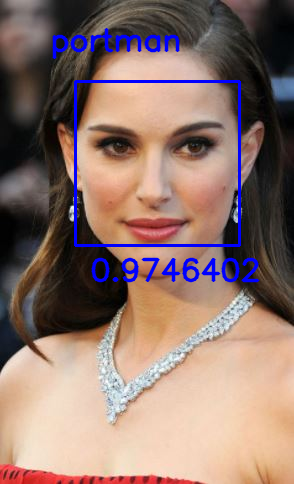

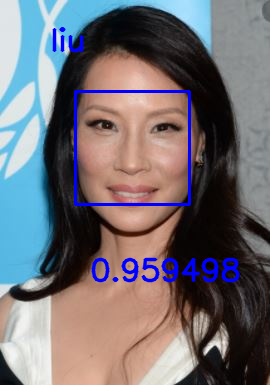

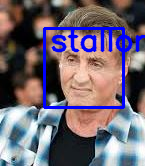

In [13]:
test_list=['portman_19.JPG' ,'liu_20.JPG', 'stallone_19.JPG'] # Pick 3 celebrities of your choice, insert the filename e.g test_list=['portman_19.JPG' ,'liu_20.JPG', 'stallone_19.JPG']

# Now we obtain the predictions for every person in the test set
for img_name in test_list:
    #Load the image

    img = cv2.imread(test_images_path + img_name)

    #Predict the similarity scores 

    predicted_scores = predict_scores(img)

    #Definition the predicted identity (name)
    name=person_rep[np.argmax(predicted_scores)]

    #Now, let's display the celebrity images with all the predicted information
    #First let's show the face bounding box, to do so we follow the steps in the previous subsection 1.1
    #Convert the image into grayscale

            #HERE YOUR CODE#
    grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects = dnnFaceDetector(grey)
    rect=rects[0]        
    
    #rect=rects[0]
    #Definition of the coordinated of the bounding box (rectangle)
    left=rect.rect.left() #x1
    top=rect.rect.top() #y1
    right=rect.rect.right() #x2
    bottom=rect.rect.bottom() #y2
    width=right-left
    height=bottom-top
    
    #Draw the face bownding box, you can use the method cv2.rectangle(image, start_point, end_point, color, thickness)

            #HERE YOUR CODE#
    start_point = (left, top) 
    end_point = (right, bottom) 
    color = (255, 0, 0)
    thickness = 2

    image = cv2.rectangle(img, start_point, end_point, color, thickness)    

    #Display the name of the predicted identity on the top (or the bottom) of the bounding box, you can use the method cv2.putText(image, text, position, font, fontScale, color, thickness, lineType)

            #HERE YOUR CODE#
    font = cv2.FONT_HERSHEY_SIMPLEX 
    org = (50, 50) 
    fontScale = 1 
    color = (255, 0, 0) 
    thickness = 2
    image = cv2.putText(image, name, org, font,  
                      fontScale, color, thickness, cv2.LINE_AA)         

    #Display the predicted similarity score of that corresponds to the predicted identity on the bottom (or the top) of the bounding box, you can use the method cv2.putText(image, text, position, font, fontScale, color, thickness, lineType)

            #HERE YOUR CODE#
     # org2
    org = (90, 280) 
    # Using cv2.putText() method 
    image = cv2.putText(image, str(tf.math.reduce_max(
    predicted_scores, ).numpy()), org, font, fontScale, color, thickness, cv2.LINE_AA)         

    #Display the celebrity images with all the predicted information

            #HERE YOUR CODE#
    cv2_imshow(image)        


**Your Answer:**

### **1.3. Genuine/Impostor similarity score distribution**



#### **1.3.1 Compute the genuine and the imposter similarity scores**

*   Genuine score: are the similarity scores of comparing pairs of images belonging to the same identity (i.e. the same person).
*   Imposter scores: are the similarity scores of comparing pairs of images belonging to different identities (i.e. different people.

If the face recognition systems works correctly, genuine similarity scores are supposed to be high, and the imposter similarity scores are supposed to be low.

In [14]:
# Complete the following code:


genuine_scores=[]
imposter_scores=[]
for filename in sorted(os.listdir(test_images_path)):
  image=cv2.imread(test_images_path+filename)
  genuine_name = filename.split('_')[0]
            #HERE YOUR CODE#
  if filename != "winfrey_19.JPG":
    predicted_scores = predict_scores(image)
    for i in range(predicted_scores[0].shape[0]):
      if person_rep[i] == genuine_name:
        #genuine_scores.append(np.argmax(predicted_scores))
        genuine_scores.append(predicted_scores[0][i])
      else:
        imposter_scores.append(predicted_scores[0][i])
      

print("genuine scores ")
print(len(genuine_scores))
print("imposter scores ")
print(len(imposter_scores))        

genuine scores 
39
imposter scores 
741


#### **1.3.2 Plot genuine and impostor scores distributions**

- Comment the plot



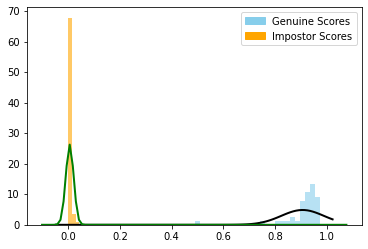

In [15]:
import matplotlib.patches as mpatches

# Plot in the same image the histogram of the genuine and the impostor scores(each with a different color) 
# Then fit a gaussian to each distribution

plt.hist(genuine_scores, bins = 25, density=True, alpha=0.6, color = "skyblue")
plt.hist(imposter_scores, bins = 25, density=True, alpha=0.6, color='orange')

# Fit a normal distribution to the genuine scores:
mu, std = norm.fit(genuine_scores)
# Plot the PDF.
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)
title = "Genuine score \nFit results: mu = %.2f,  std = %.2f" % (mu, std)

# Fit a normal distribution to the genuine scores:
mu, std = norm.fit(imposter_scores)
# Plot the PDF.
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'g', linewidth=2)
title = "Genuine score \nFit results: mu = %.2f,  std = %.2f" % (mu, std)

blue_patch = mpatches.Patch(color='skyblue', label='Genuine Scores')
orange_patch = mpatches.Patch(color='orange', label='Impostor Scores')
plt.legend(handles=[blue_patch, orange_patch])

plt.show()

**Your Answer:**

### **1.4. Plot the Receiver Operating Characteristic (ROC) curve**

- Comment the plot


**Your Answer:**

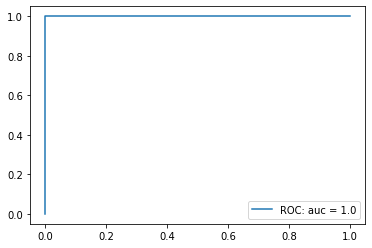

0.49015445
0.34277976


In [16]:
# You can use an existing function like sklearn.metrics.roc_curve
            #HERE YOUR CODE#
y_true = np.zeros(len(genuine_scores)+ len(imposter_scores))
y_true[0 : len(genuine_scores)] = 1
y_hat = genuine_scores + imposter_scores

fpr, tpr, thresholds = metrics.roc_curve(y_true, y_hat, pos_label=1)
auc = metrics.roc_auc_score(y_true, y_hat)
plt.plot(fpr, tpr, label="ROC: auc = " + str(auc))
plt.legend( loc = 4)
plt.show()

print(np.min(genuine_scores))
print(np.max(imposter_scores))

### **1.5. Deduce the score threshold**

- Define a face verification function, verification answers to the question “Is he/she the person he/she claims to be?”. So the face_verification function will take as input an identity (name) and a face image (input_image) and returns a message that says if the person is in the guest list or not. In this function, you have to define a similarity score threshold deduced from the previous plots.
- If the similarity score of the image given as an input with the class of the person of which the identity is given as input is **lower than the threshold**, than the request to access the Cannes Festival will be rejected and the face_verification function will return the following message "Sorry! your name is not on the guest list for the Cannes Festival!".

- If the similarity score of the image given as an input with the class of the person of which the identity is given as input is **higher than the threshold**, than the request to access the Cannes Festival will be accepted and the face_verification function will return the following message "Welcome,", <name>, ", to the Cannes festival!".

**Question:** What happens if we lower or increase the threshold? For which application can we use a lower/higher threshold? What are the consequences?


In [17]:
# Complete the following code: 
threshold= 0.90713215

def face_verification(name, input_image):
  #First define the similarity score threshold
              #HERE YOUR CODE#
  #threshold= 0.90713215
  
  #Then generate the prediction scores of the image input_image
              #HERE YOUR CODE#
  scores = np.asarray(predict_scores(input_image))

  #Finally, develop the face verification step 
              #HERE YOUR CODE#
  person_position = [key for key, value in person_rep.items() if value == name][0]
  if scores[0][person_position]>=threshold:
    res = "Welcome, " + name + ", to the Cannes festival!"
  else:
    res = "Sorry! your name is not on the guest list for the Cannes Festival!"
  return res          

**Your Answer:**

Perform the face verification experiment on all the images in the testset, for a celebrity of your choice.

In [18]:
for filename in sorted(os.listdir(test_images_path)):
  image=cv2.imread(test_images_path+filename)
  if filename != "winfrey_19.JPG":
    res = face_verification("aniston", image) # Check for a celebrity of your choice
    #print(res)

# **2. Face morphing attack**

A morphed face image is a synthetically created image that looks so similar to the faces of two subjects that both can use it for verification against a biometric verification system. 

In this section of the challenge, we will use this technique to modify your picture and generate a new image that will be succesfully classified as one celebrity in the dataset but that visually will also look as yourself. 

### **2.0. Tools preparation** 


Import the face processing functions needed for creating the morphing attack.

In [19]:
import sys  
sys.path.insert(0, '/gdrive/MyDrive/BiometricChallenge/')
from morph import load_image_points, weighted_average_points, warp_image, mask_from_points, weighted_average, overlay_image

Load the facial landmark detector (68 points). The facial landmarks will be later used to align the 2 images used for the morphing attack.


In [20]:
dlib_predictor = dlib.shape_predictor('/gdrive/MyDrive/BiometricChallenge/shape_predictor_68_face_landmarks.dat')

### **2.1. Define the morphing attack function**



Define morph_face function that takes as an input a source image, a target image and a weight value between 0 and 1 and it returns a morphed face.

Here a description of all the functions (imported in 2.0.) that you need for the face morphing.

 

*   load_image_points(img, size, dlib_predictor ): Locates 68 face points using dlib shape predictor and then it resizes image and associated points, align the face to the center and crop to the desired size. The function returns 2 outputs: the aligned, cropped and resize image and the 68 facial landmark points.
*   weighted_average_points(start_points, end_points, percent=0.5) : it returns a weighted average of two sets of supplied points.
*   warp_image(src_img, src_points, dest_points, dest_shape, dtype=np.uint8): it warps each triangle from the src_image only within the region of interest ROI of the destination image (points in dst_points). The function returns the warped image.
*   mask_from_points(size, points): it creates and returns a mask of supplied size from supplied points.
*   weighted_average(img1, img2, percent=0.5): it returns an image that is a weighted average of the two images given as input.
*   overlay_image(foreground_image, mask, background_image): it overlays foreground image onto the background given a mask and returns the resulting image.








In [21]:
# Complete the following code:

def morph_face(src_img, dest_img, percent):
  size=(600,500)
  #First, we detect the 68 facial landmark points, we align, crop and resize the two images
  #The source image is your picture
  #The destination image is the image of the celebrity that you will be stealing his identity
  
            #HERE YOUR CODE#
  src_image_m, src_points = load_image_points(src_img, size, dlib_predictor)
  dest_image_m, dest_points = load_image_points(dest_img, size, dlib_predictor)
  

  #Next, we compute the weighted average of the two sets of 68 facial landmarks
 
            #HERE YOUR CODE#
  weighted_avg_points = weighted_average_points(src_points, dest_points, percent)

  #Then, we warp the two images according to the weighted average of the two sets of the 68 facial landmarks

             #HERE YOUR CODE# 
  warp_src = warp_image(src_image_m, src_points, weighted_avg_points, size, dtype=np.uint8)
  warp_dest = warp_image(dest_image_m, src_points, weighted_avg_points, size, dtype=np.uint8)


  #To get the morphed face, we compute the weighted average of the two warped images

             #HERE YOUR CODE#
  foreground_image = weighted_average(warp_src, warp_dest, percent)

  #To give the morphed image more credibility, we also compute the weighted average of the background
 
            #HERE YOUR CODE#
  background_image = weighted_average(src_image_m, dest_image_m, percent)

  #We define the mask in which the morphed face will be placed, and that's according to the weighted average of the two sets of the 68 facial landmarks
  
            #HERE YOUR CODE#
  mask = mask_from_points(size, weighted_avg_points)
  #Finally, we overlay the morphed face and the wieghted average background to get the final picture
  
  #average_face =  #HERE YOUR CODE#
  average_face = overlay_image(foreground_image, mask, background_image)

  return average_face

### **2.2. Preparation of your face image**

Take a picture of yourself, using your cellphone (easiest option) or a camera, and upload it on your google drive under the following path: /gdrive/MyDrive/BiometricChallenge/. Verify if you uploaded your picture in the right folder.


In [22]:
!ls /content/drive/MyDrive/BiometricChallenge/

ls: cannot access '/content/drive/MyDrive/BiometricChallenge/': No such file or directory


### **2.3. First morphing attack attempt**
- Generate a morphing attack using 50% of your face image and 50% of a face image of a celebrity of your choice and apply the face_verification() function to it.

**N.B.:** if you get a memory error, it might be due to the big size of your face image, try to sample it down, using cv2.resize. 


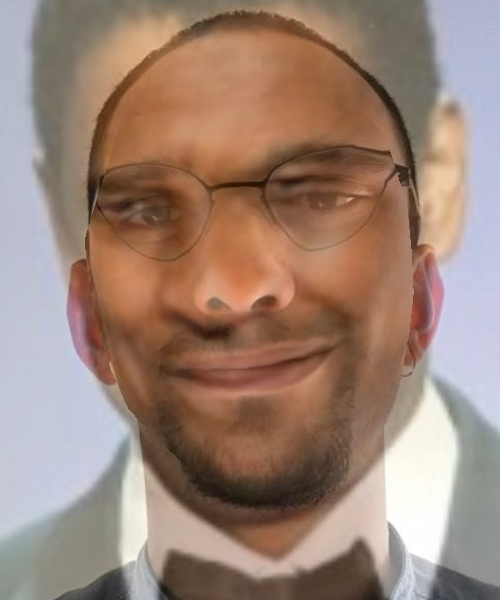

In [26]:
# Complete the following code:

src_image= cv2.imread('/gdrive/MyDrive/BiometricChallenge/Paolo.jpeg') #your face image
dest_image=cv2.imread(test_images_path + 'washington_19.JPG') # the face image of the celebrity

# First try with 50% morphed face

            #HERE YOUR CODE#
morph_image = morph_face(src_image, dest_image, percent=0.50)
#plot the morphed image 

            #HERE YOUR CODE#
cv2_imshow(morph_image)

### **2.4. Generate a morphed face from you picture and a picture of the celebrity that looks like you the most.**


- Get the similarity scores with all the celebrities (20) that are enrolled, who do you look like the most?


In [28]:
#First, load your image
            #HERE YOUR CODE#
input_image= cv2.imread('/gdrive/MyDrive/BiometricChallenge/Paolo.jpeg') #your face image

#Then, generate the predicted similarity scores to all the 20 celebrities.
            #HERE YOUR CODE#
predicted_scores = predict_scores(input_image)

#Finally, check which of the celebrities looks the most like you (i.e. with which you have the highest similarity score)
            #HERE YOUR CODE#
name = person_rep[np.argmax(predicted_scores)]
print(name)


wood


**Your Answer:**

- Generate various morphed faces (100) depending on the weight given to each of the identities (your identity, and the identity of the celebrity that you look like the most).

- Plot the morphed images at each iteration.


0.0


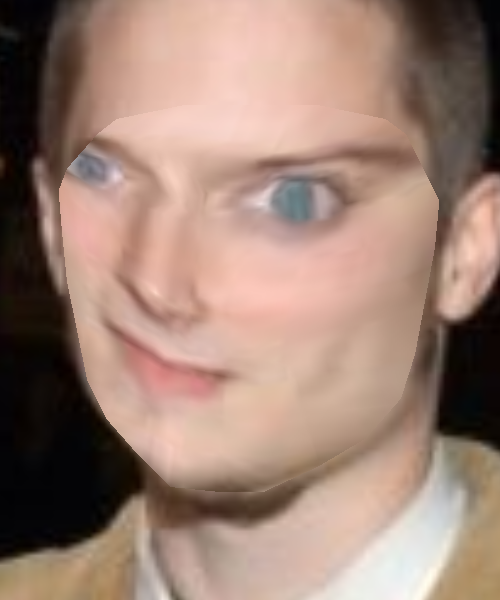

0.31945634
0.01


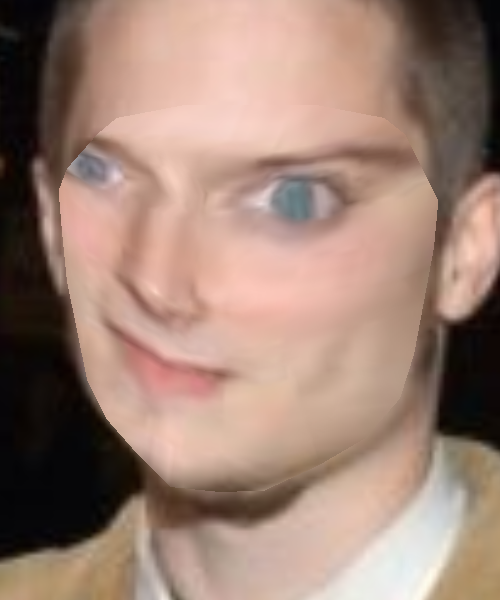

0.32707787
0.02


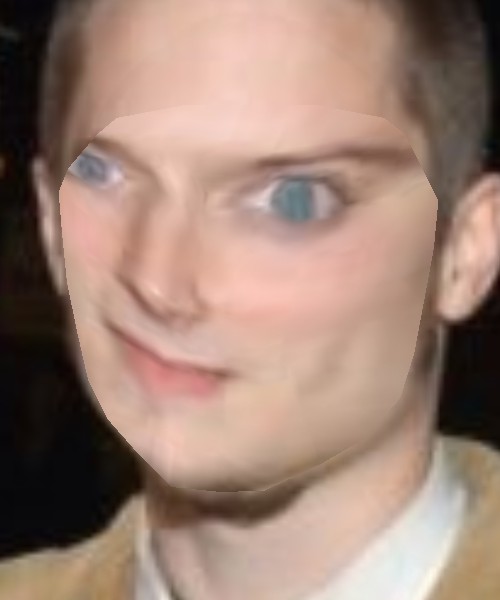

0.35891205
0.03


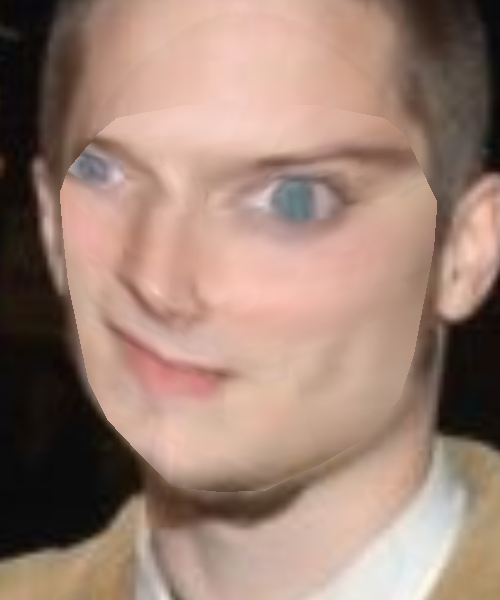

0.41916615
0.04


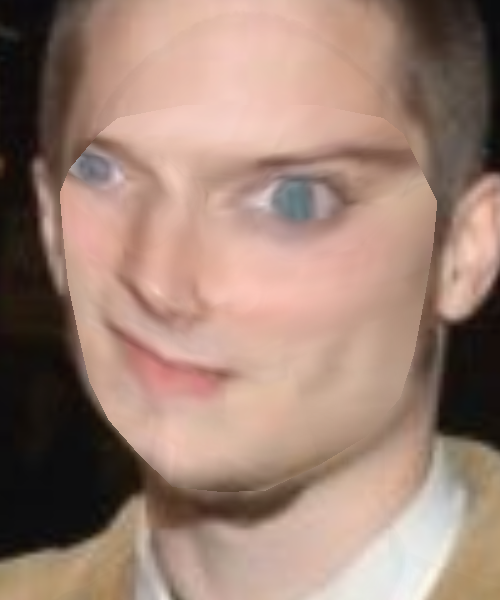

0.46736765
0.05


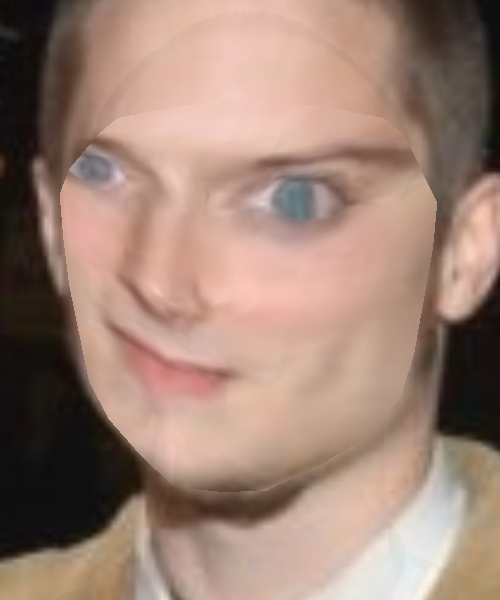

0.4994211
0.06


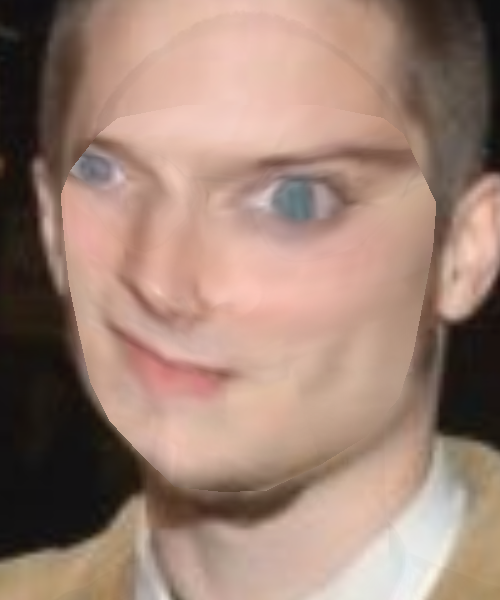

0.56551087
0.07


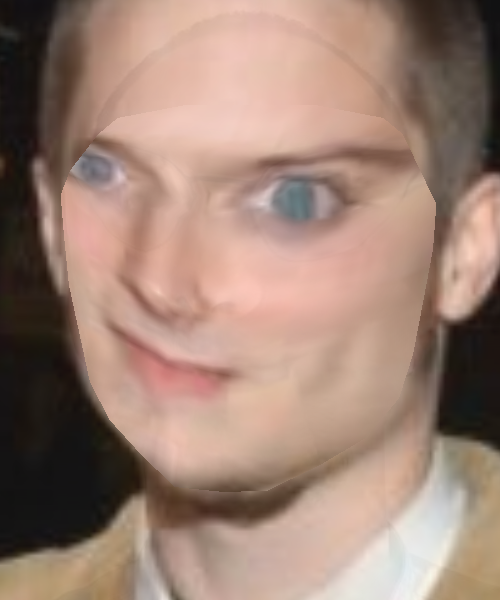

0.52053505
0.08


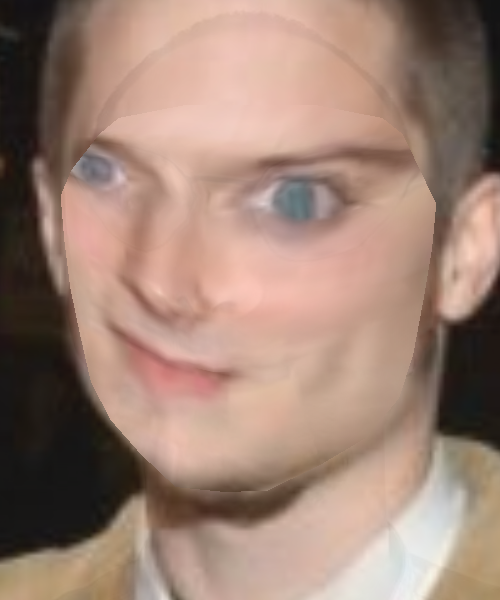

0.55729455
0.09


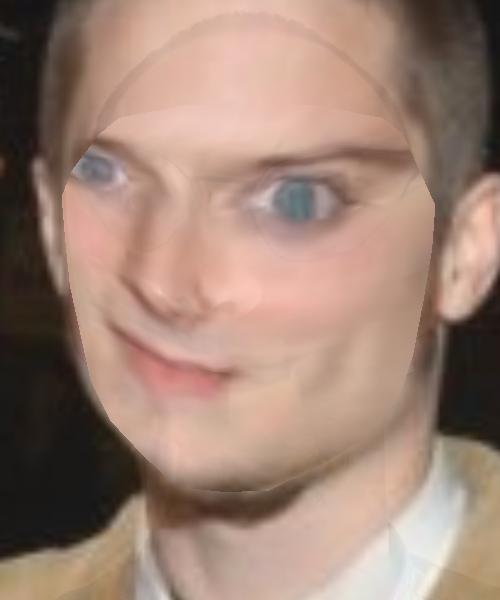

0.6194162
0.1


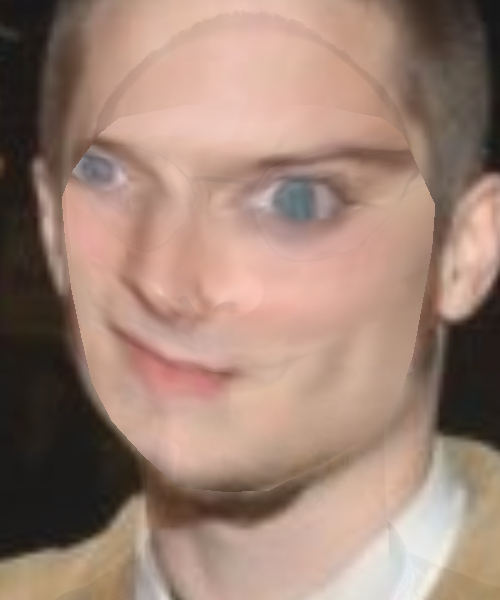

0.56329364
0.11


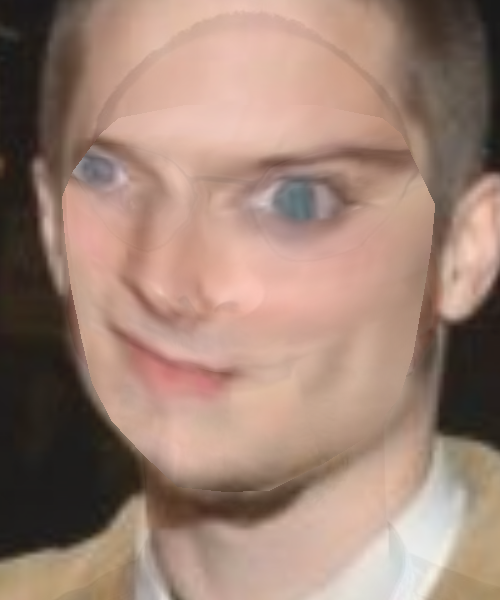

0.5811278
0.12


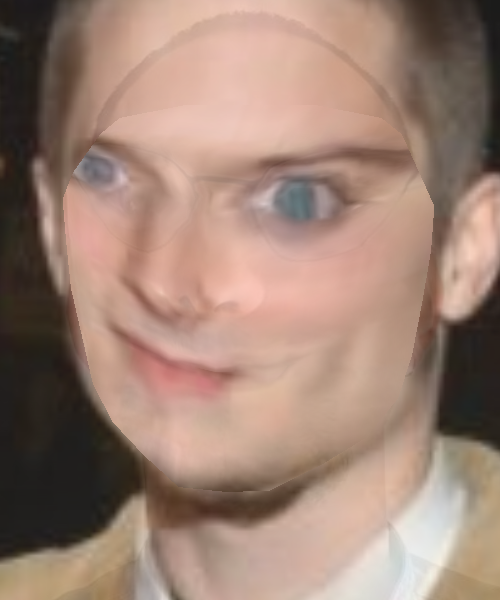

0.55570436
0.13


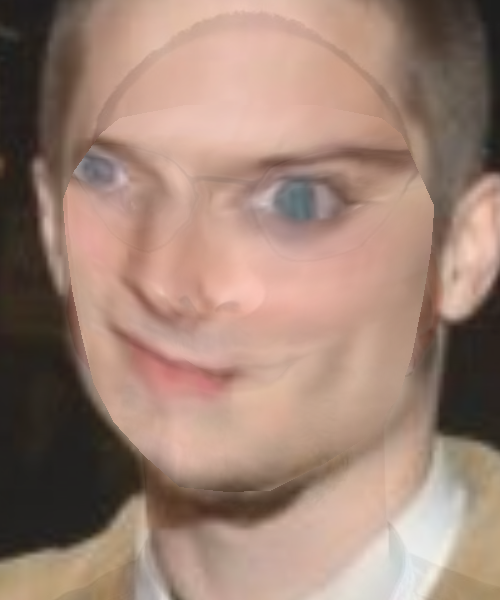

0.6173666
0.14


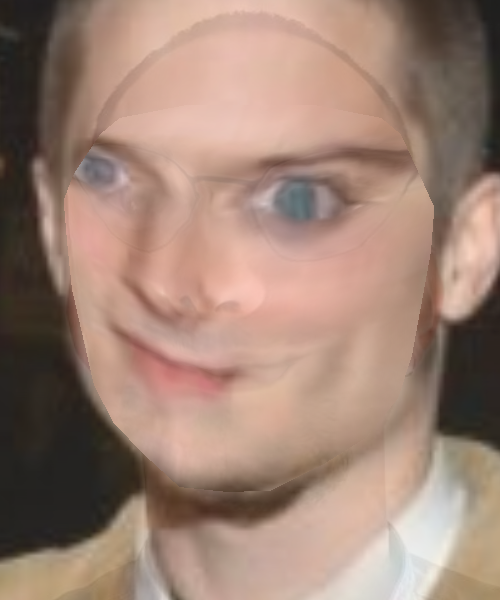

0.5445564
0.15


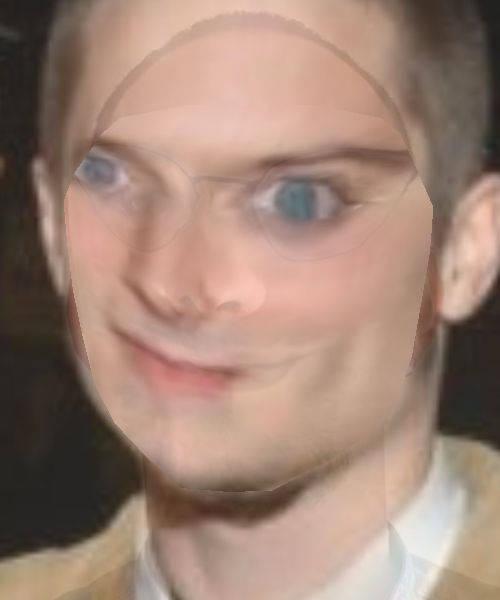

0.53483635
0.16


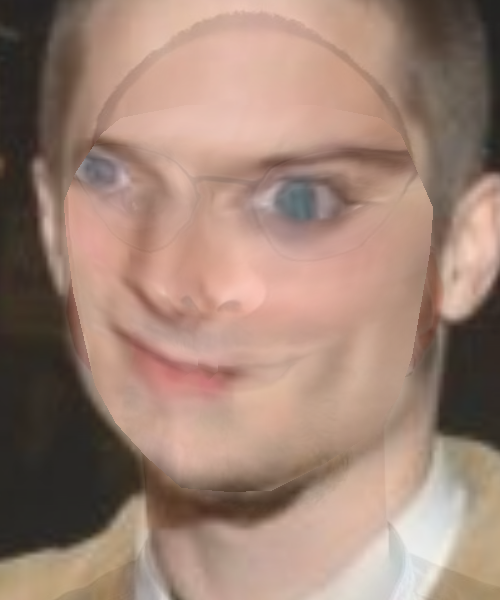

0.51503795
0.17


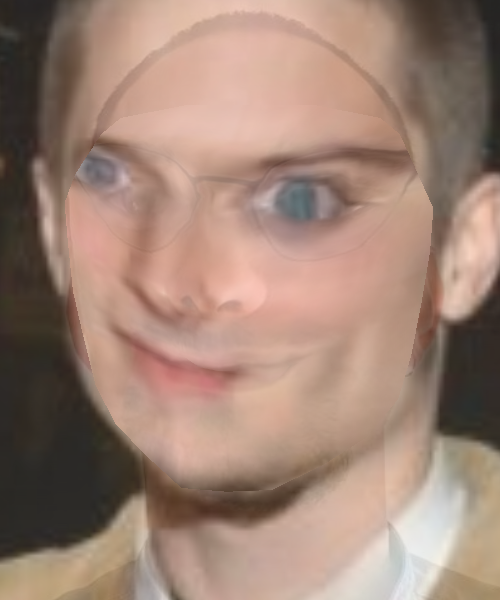

0.54966193
0.18


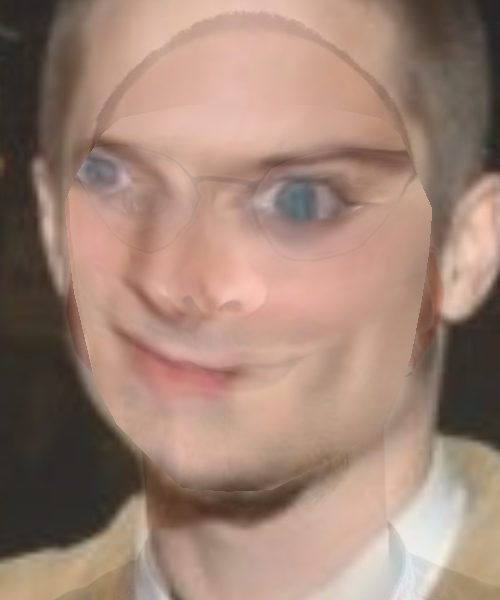

0.52627605
0.19


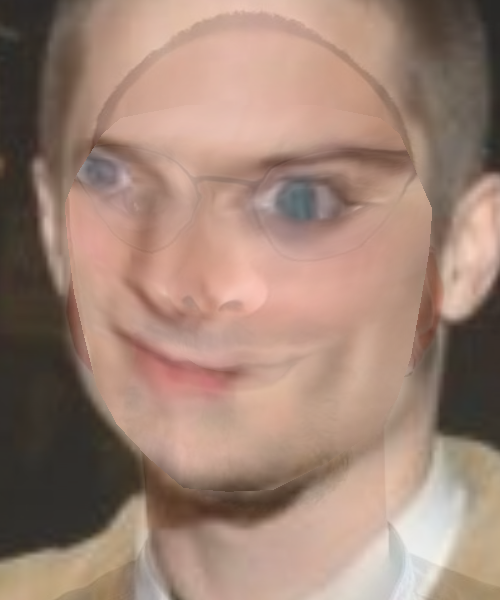

0.47630715
0.2


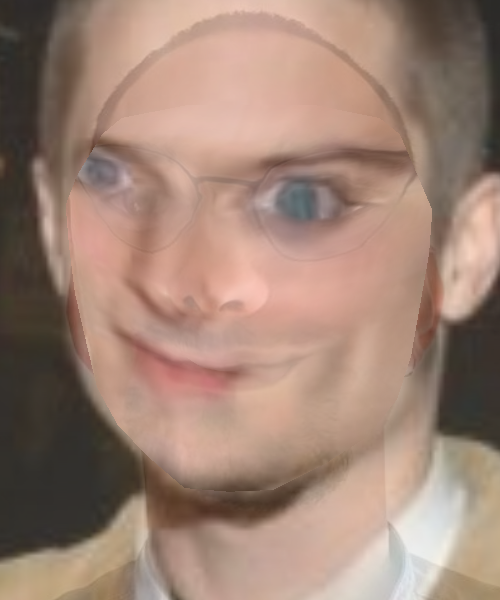

0.46880457
0.21


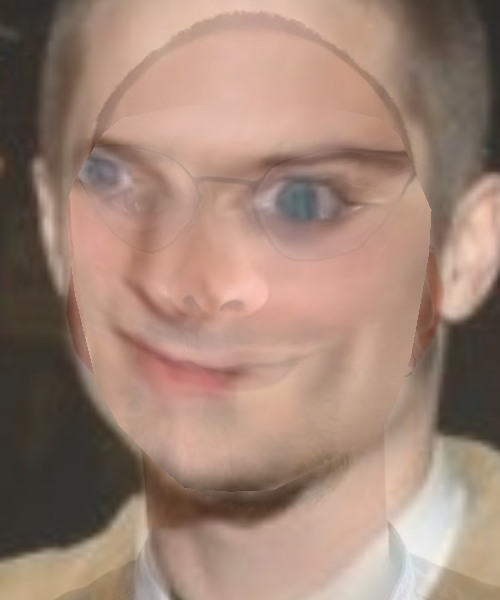

0.46070826
0.22


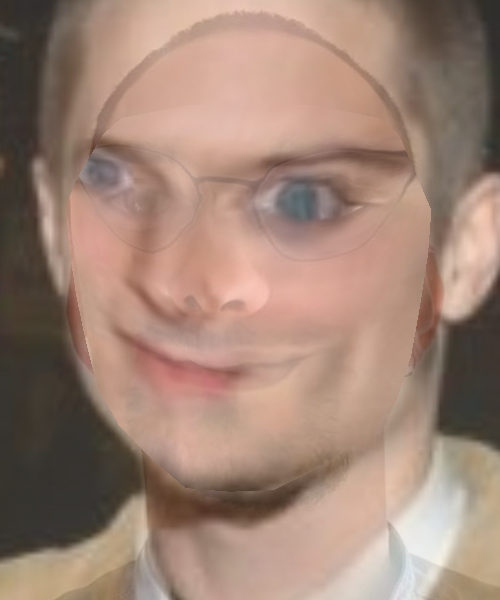

0.41067794
0.23


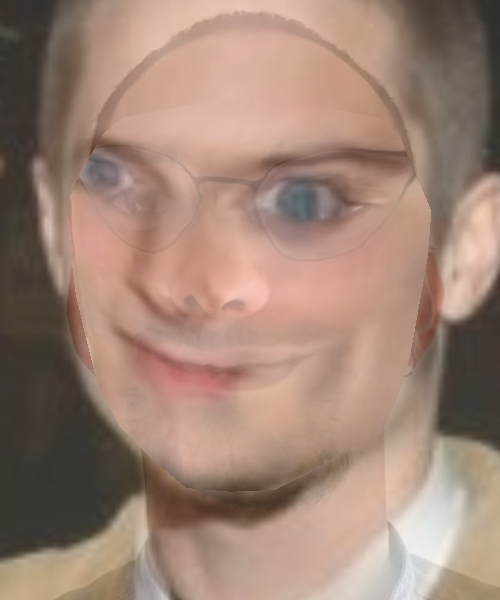

error: ignored

In [38]:


# Complete the following code:
input_image= cv2.imread('/gdrive/MyDrive/BiometricChallenge/Paolo.jpeg') #your face image
dest_image_alike=cv2.imread(test_images_path + 'wood_19.JPG') #the image of the celebrity that you look like the most
scores_morph_alike=[]
for percent in np.linspace(0, 1,101):
  #generate the morphed face accroding to the percentage
              #HERE YOUR CODE#
  print(percent)
  morph_image = morph_face(input_image, dest_image_alike, percent=percent)
  cv2_imshow(morph_image)

  #predict the similarity score to the selected celebrity
              #HERE YOUR CODE#
  predicted_scores = predict_scores(morph_image)

  #append the obtained similarity score to the list 'scores_morph_alike' 
              #HERE YOUR CODE#
  print(predicted_scores[0][10])
  scores_morph_alike.append(predicted_scores[0][14])

- Plot the similarity score for each of the (100) morphed faces, pick the morphed image that gives a similarity score that is over the threshold (defined in the previous section) and looks the most like you. 
- Comment on the plot and the image selected.
- Once the morphed image is selected, specify in your answer the weight assigned to your face image, and the weighted assigned to the celebrity's face image, as well as the similarity score obtained by comparing the selected morphed image to the class of the target celebrity.


In [32]:
#HERE YOUR CODE#
res = [ele for ele in scores_morph_alike if ele >= threshold]
print(res)

[]


**Your Answer:**

### **2.5. Pick a cross-gender/cross-ethnicity celebrity of your choice.**
Choose a celebrity that doesn't have the same gender AND the same ethnicity as you.

- Generate various morphed faces (100) depending on the weight given to each of the identities (your identity, and the identity of the cross-gender/cross-ethnicity celebrityt).

- Plot the morphed images at each iteration.


0.0


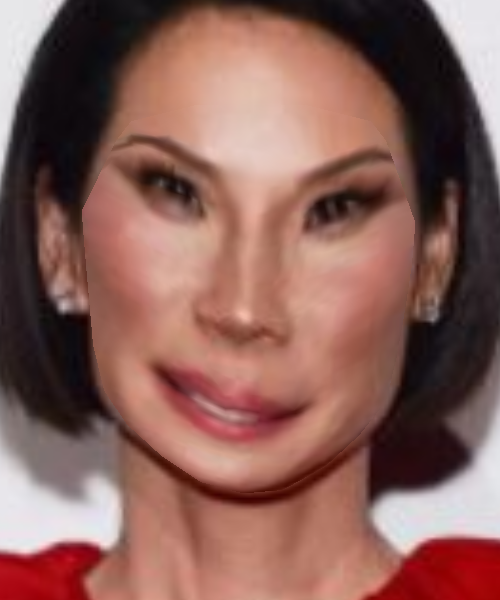

0.5939513
0.01


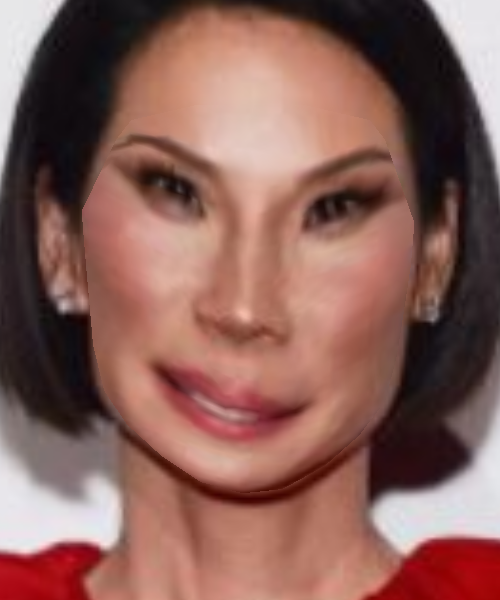

0.60887825
0.02


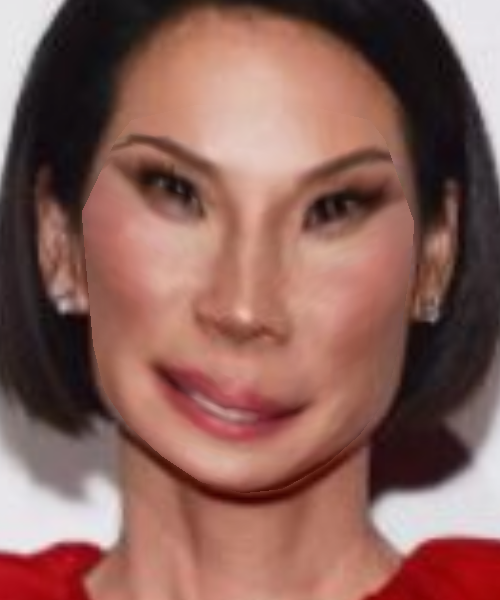

0.607174
0.03


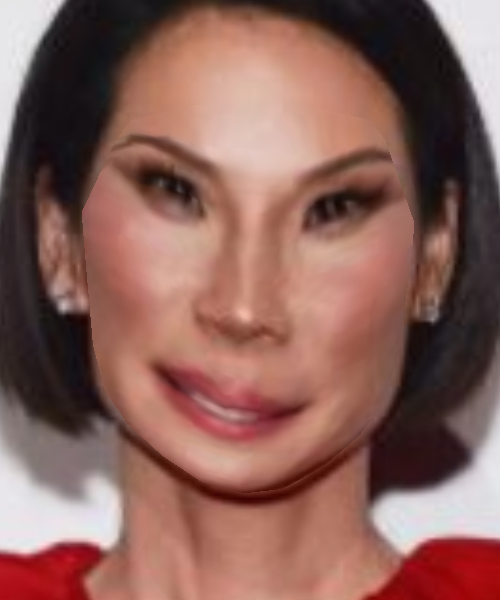

0.6202531
0.04


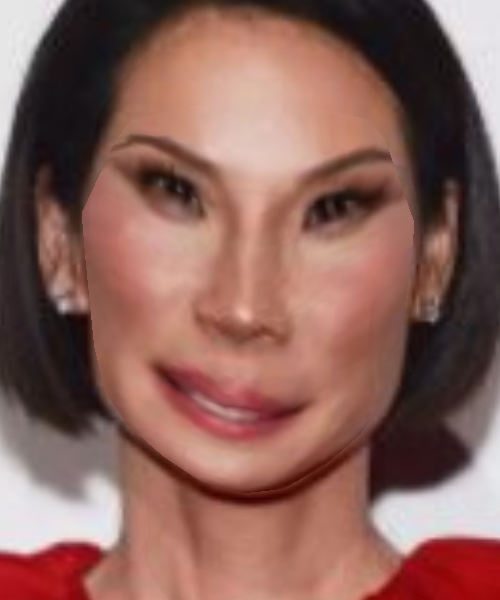

0.6094647
0.05


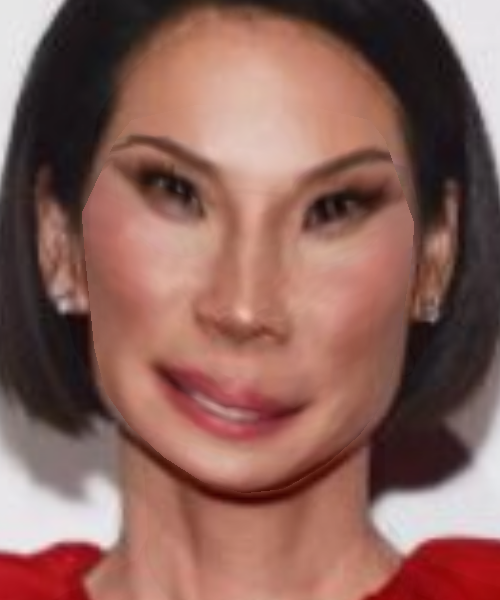

0.35602105
0.06


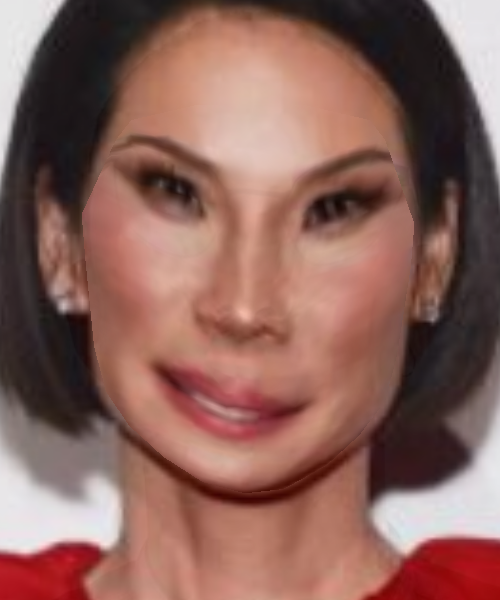

0.29944164
0.07


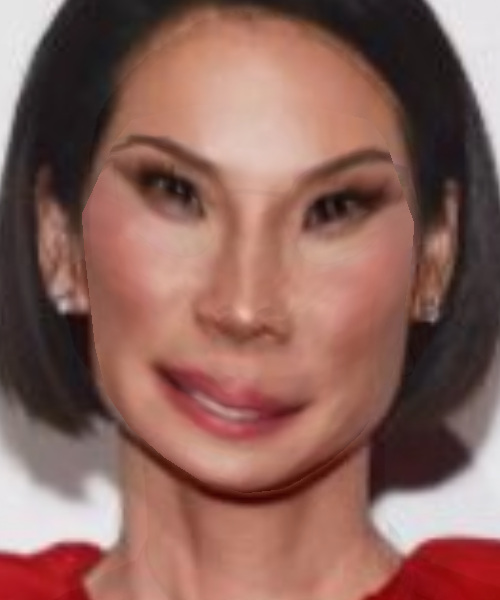

0.2714396
0.08


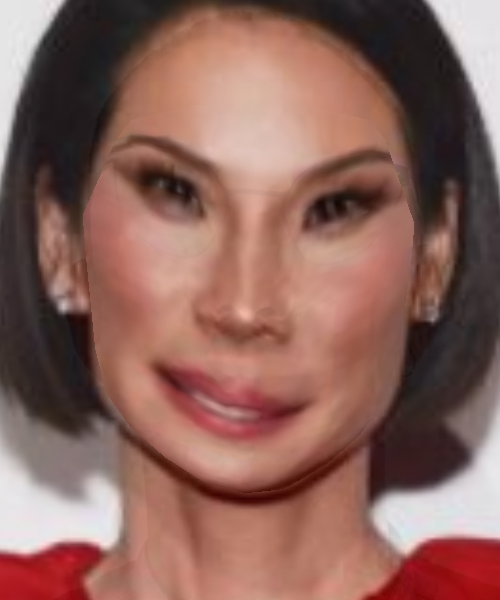

0.26616752
0.09


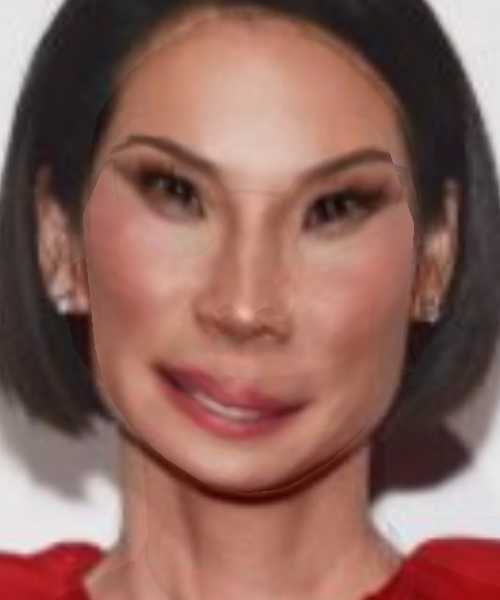

0.19083297
0.1


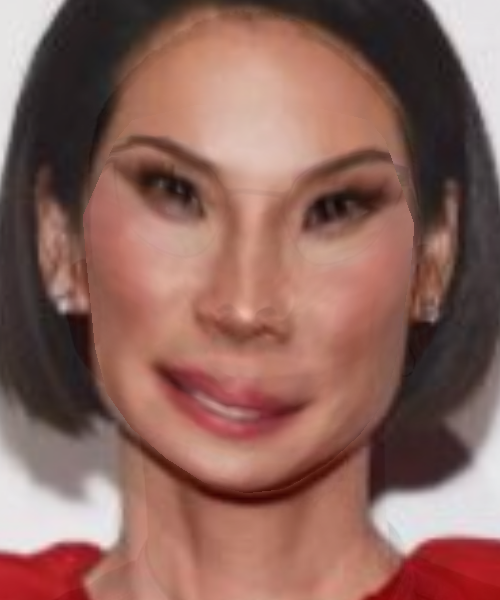

0.15271093
0.11


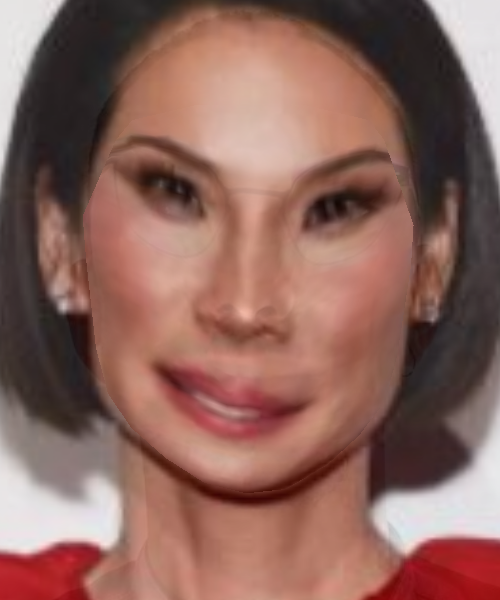

0.12892576
0.12


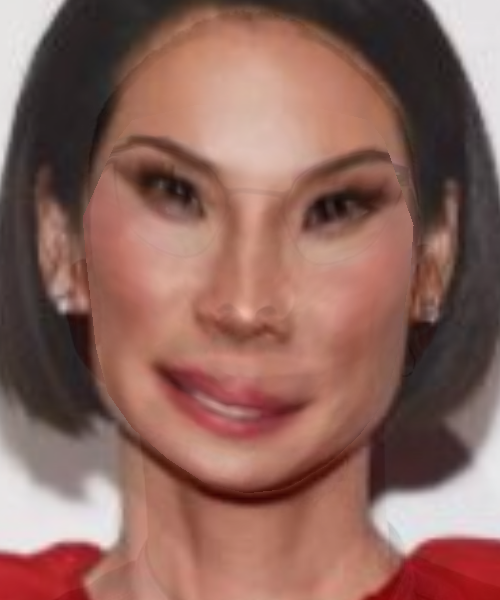

0.10955512
0.13


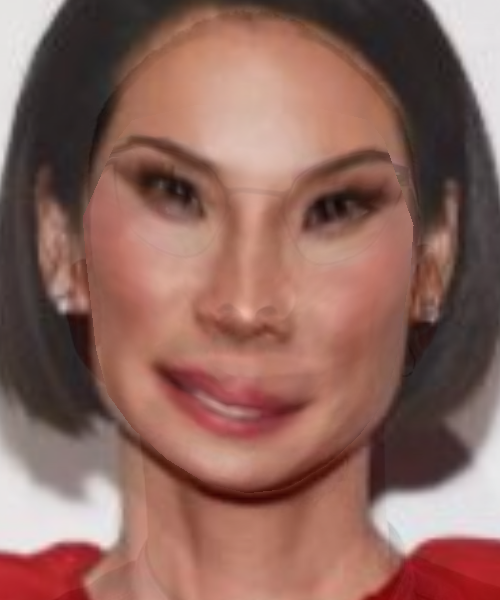

0.08661441
0.14


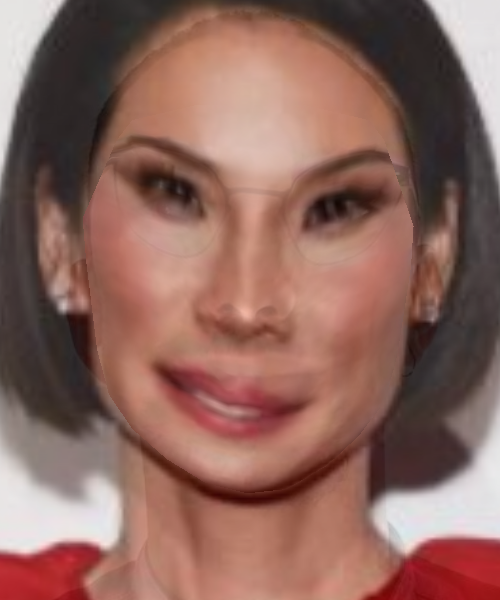

0.06651517
0.15


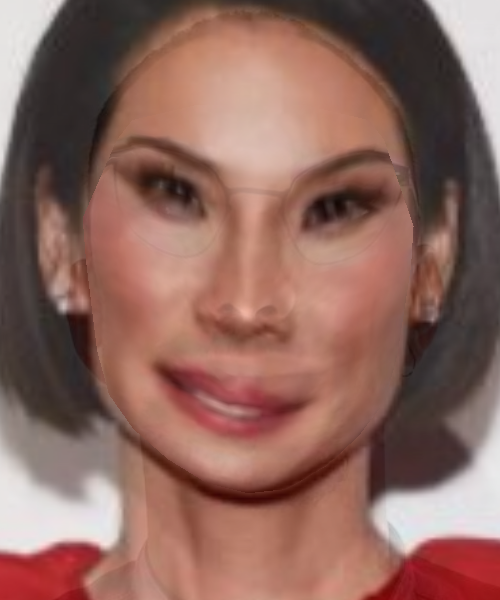

0.062087335
0.16


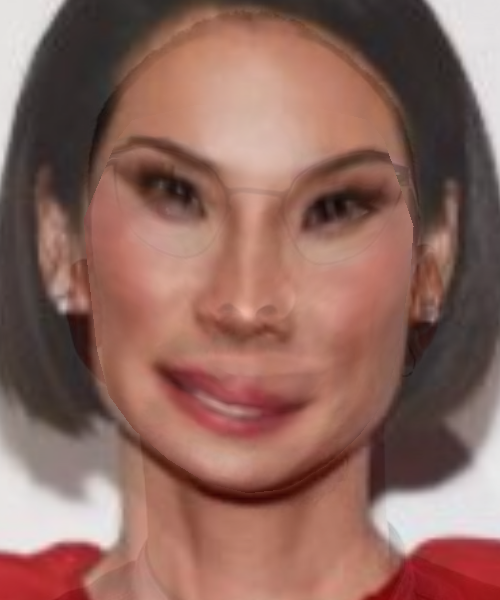

0.05150953
0.17


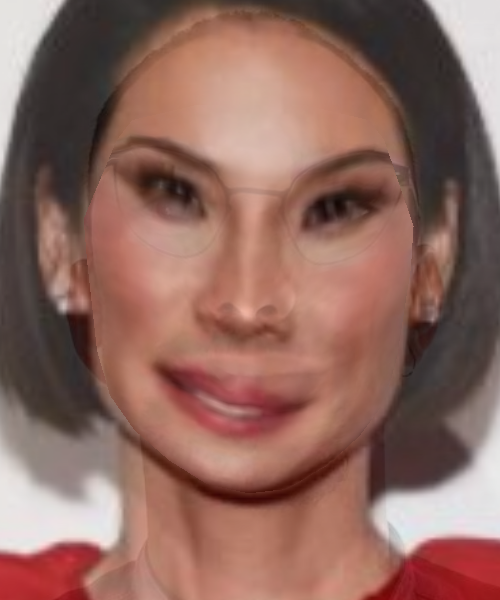

0.03628198
0.18


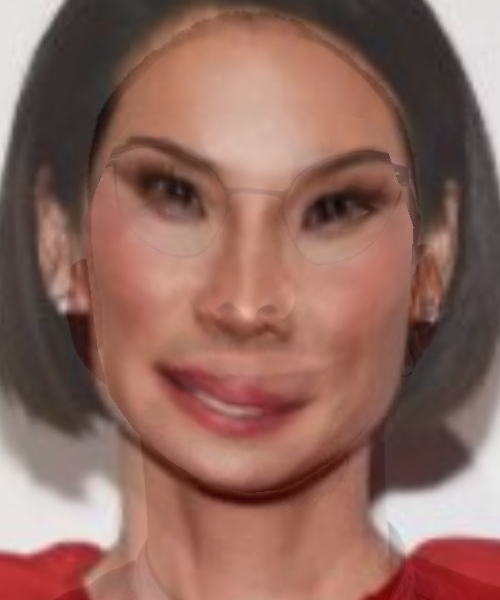

0.02570618
0.19


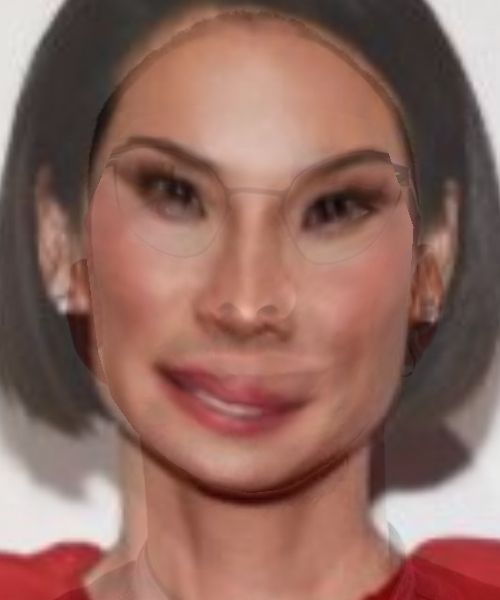

0.021890761
0.2


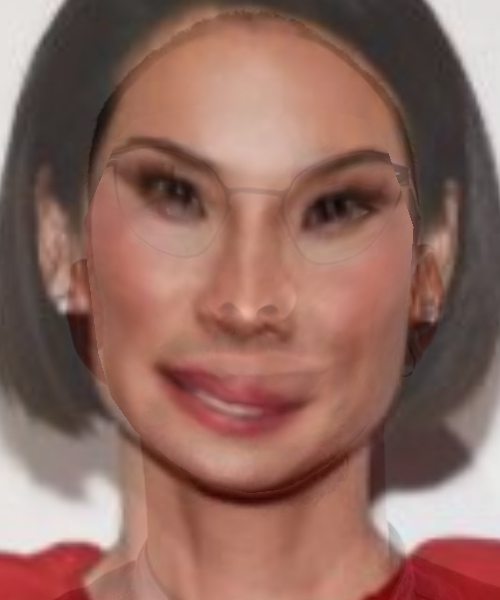

0.014000655
0.21


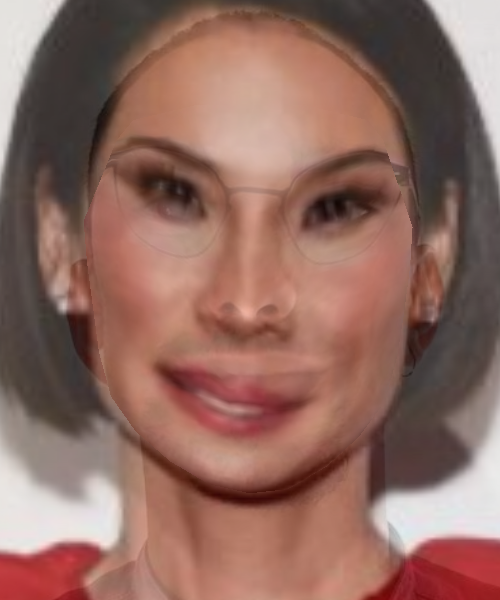

0.011871573
0.22


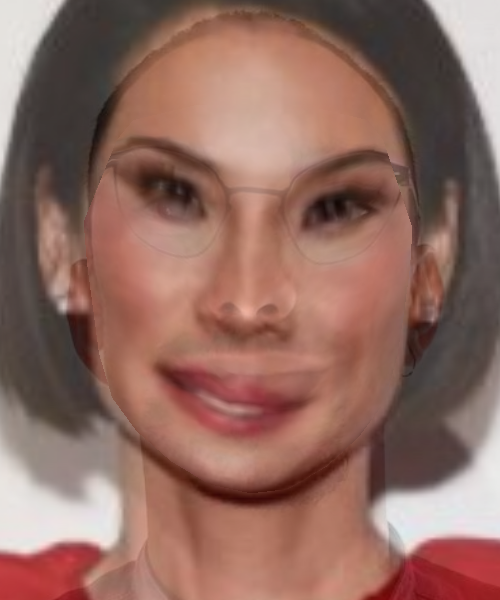

0.010725276
0.23


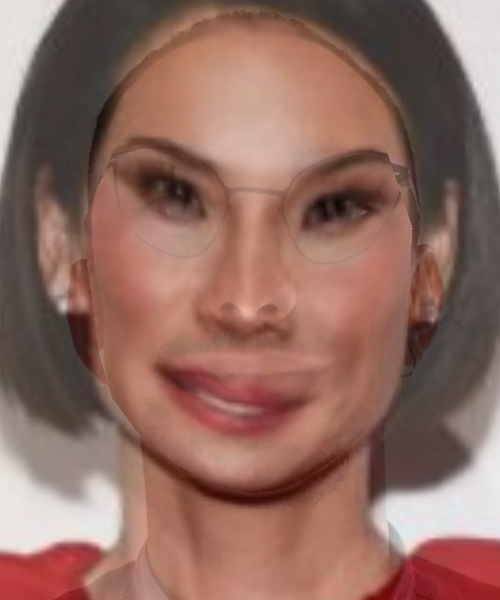

0.010990267
0.24


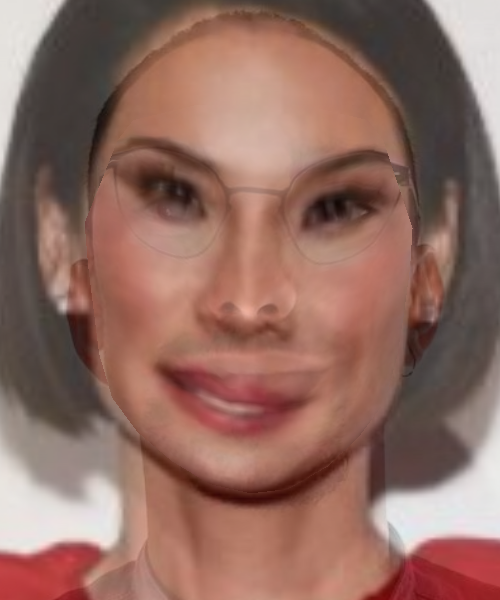

0.009536247
0.25


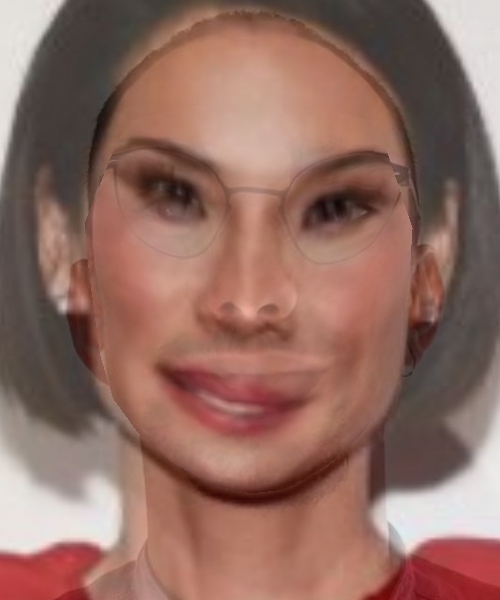

0.008857755
0.26


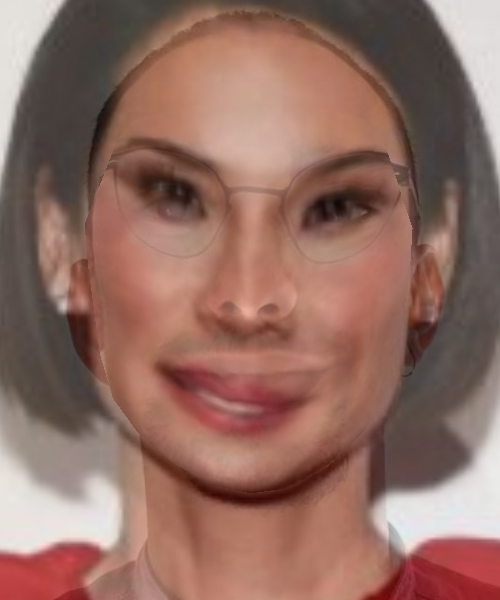

0.007827379
0.27


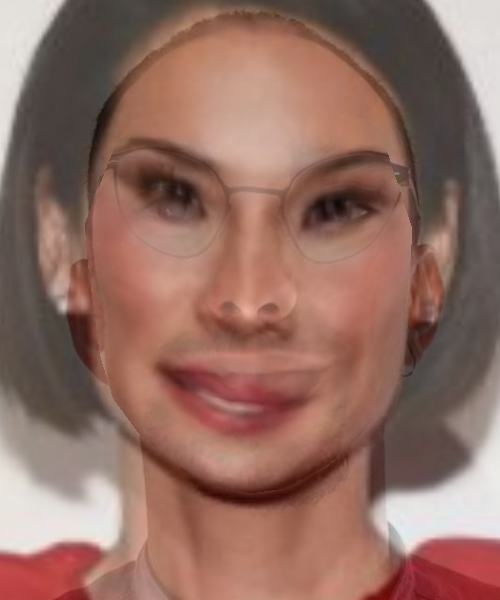

0.028929297
0.28


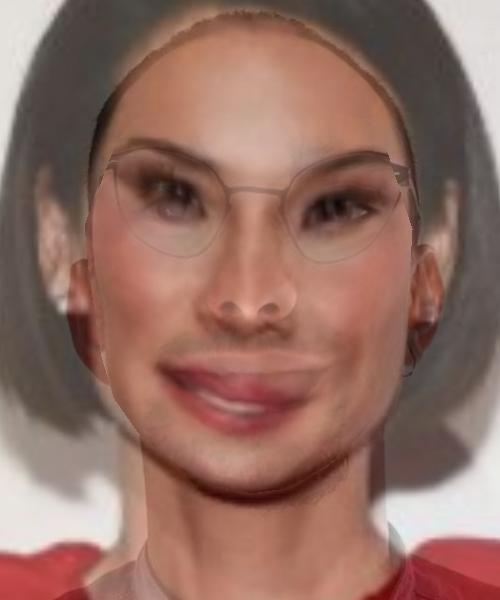

0.028095989
0.29


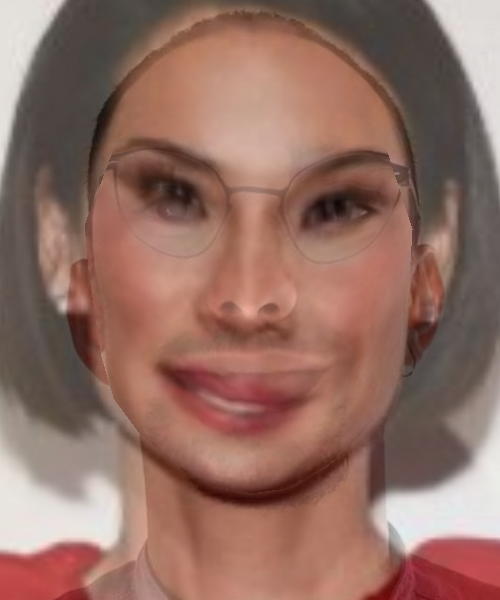

0.031945728
0.3


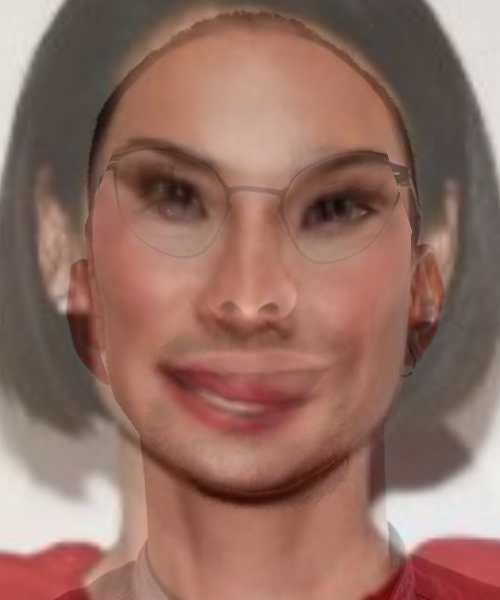

0.034953896
0.31


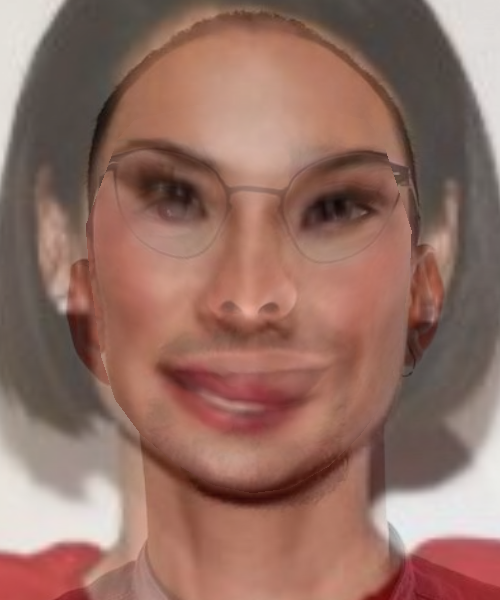

0.029097723
0.32


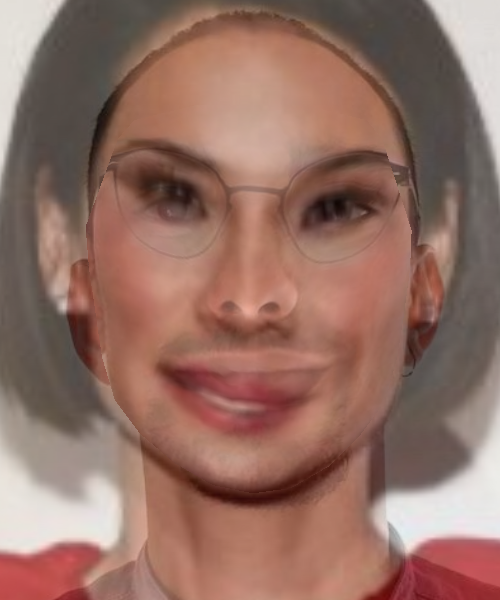

0.03517719
0.33


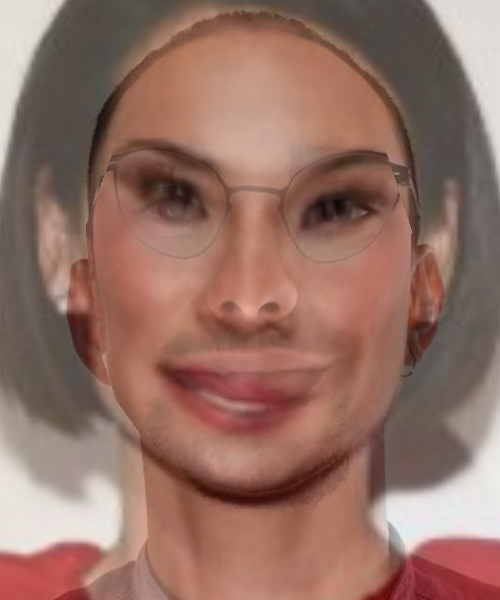

0.03317033
0.34


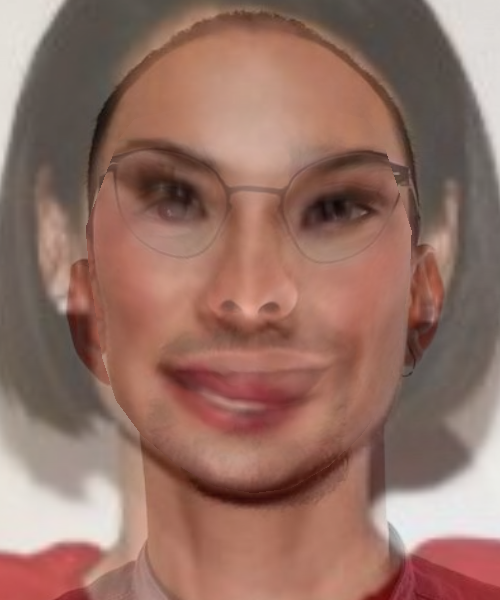

0.02866962
0.35000000000000003


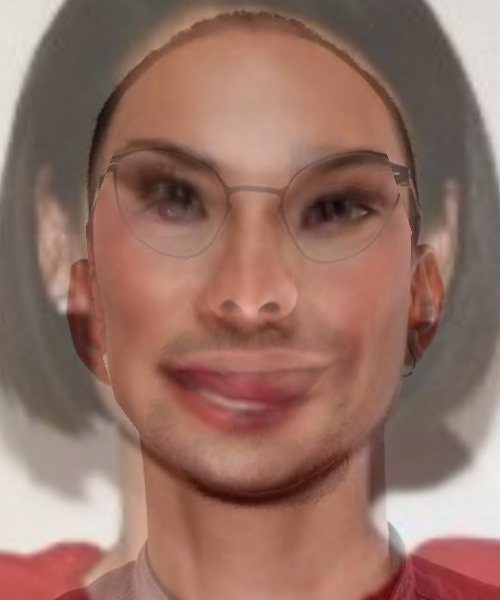

0.029007321
0.36


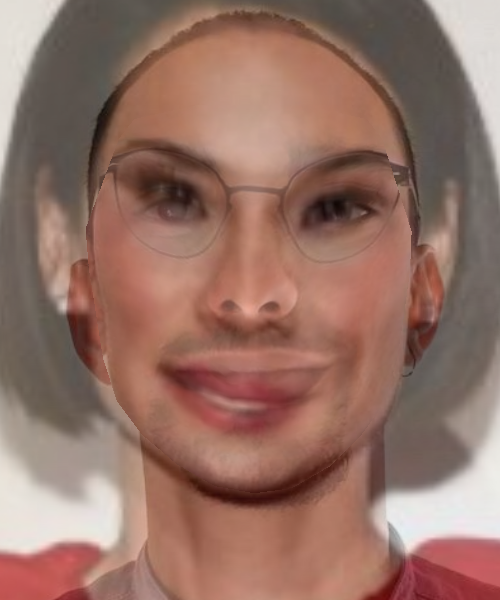

0.028270993
0.37


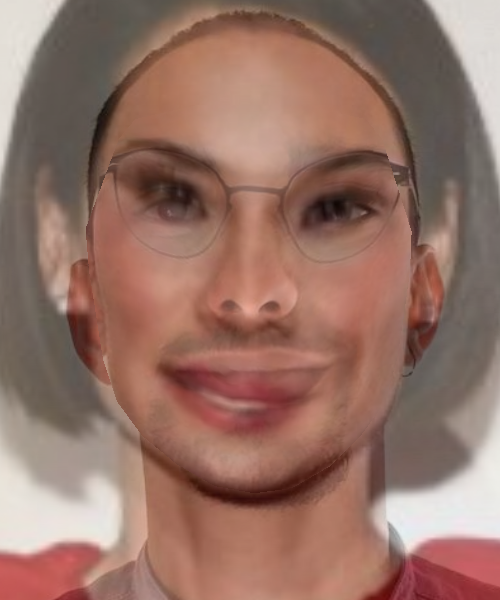

0.028775373
0.38


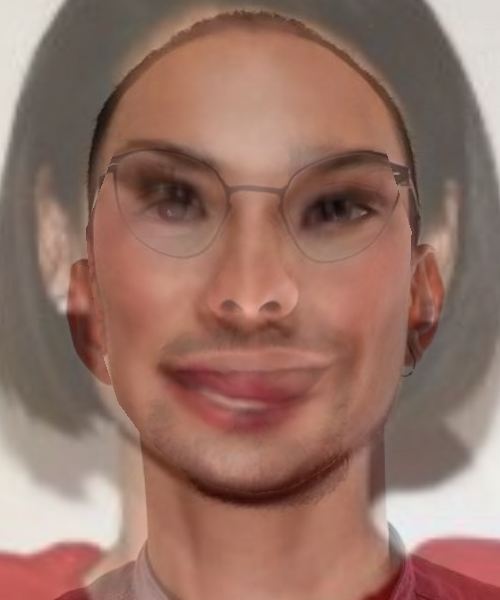

0.031036196
0.39


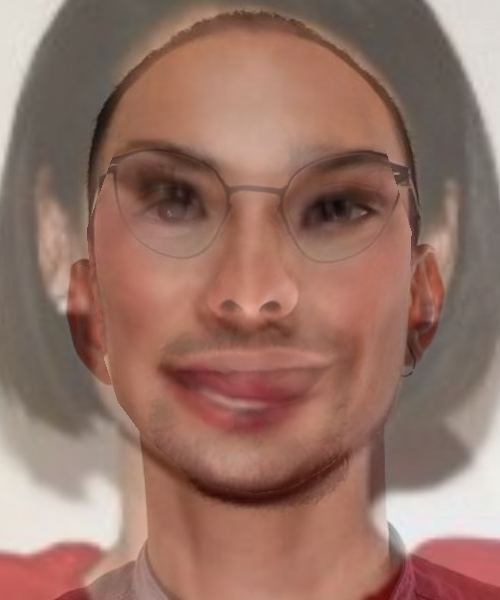

0.03183936
0.4


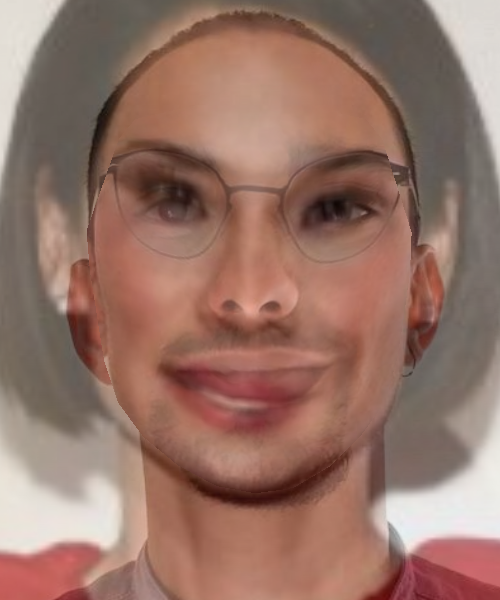

0.028683724
0.41000000000000003


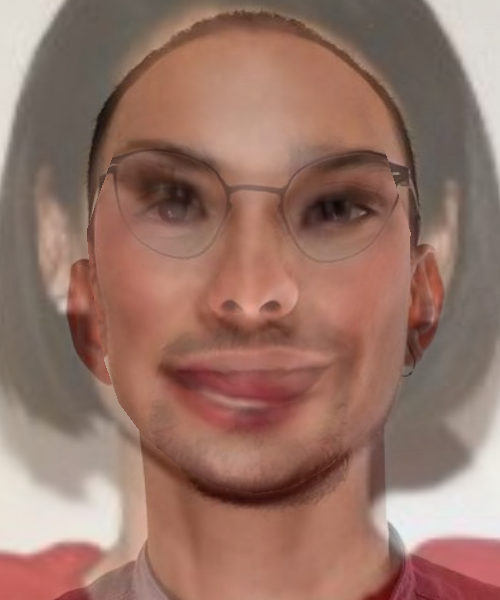

0.030964512
0.42


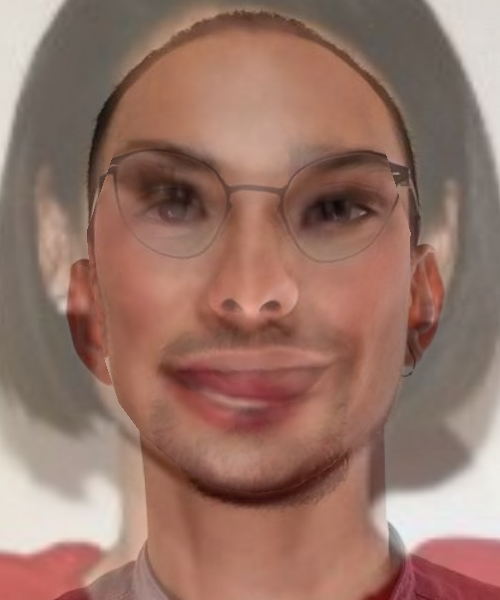

0.028955892
0.43


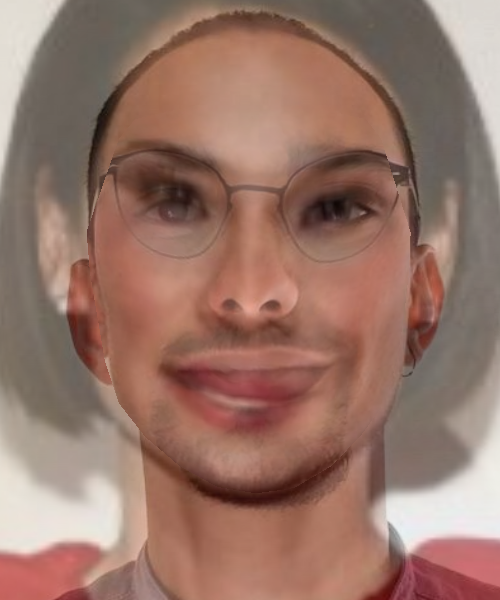

0.039443072
0.44


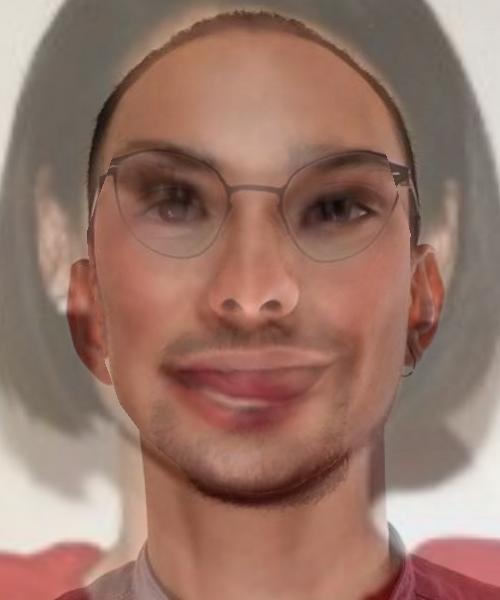

0.03792802
0.45


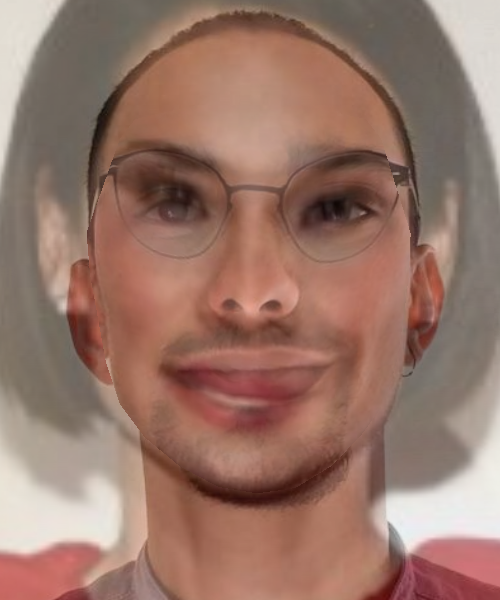

0.039450858
0.46


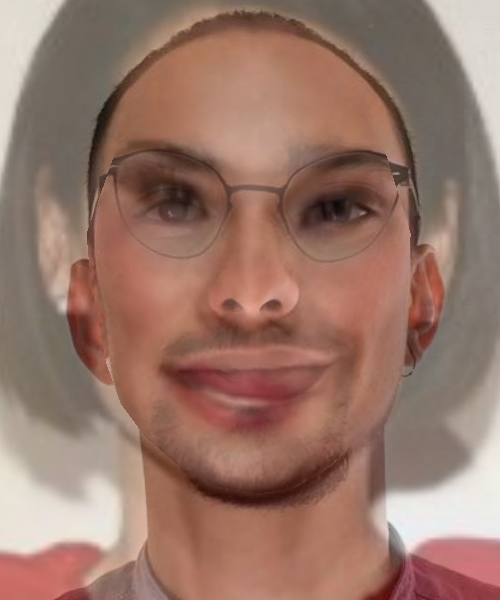

0.03938427
0.47000000000000003


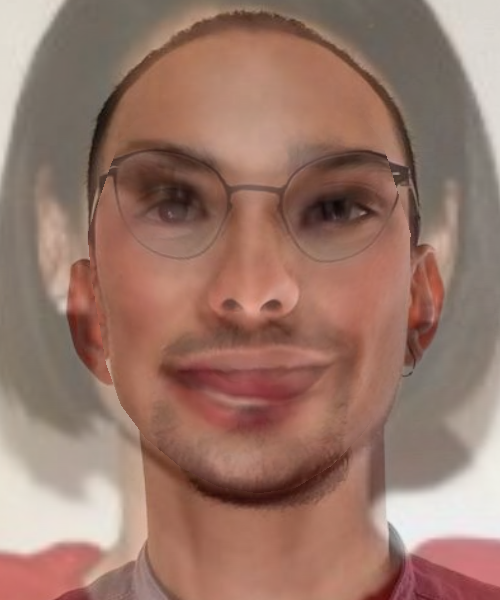

0.03840228
0.48


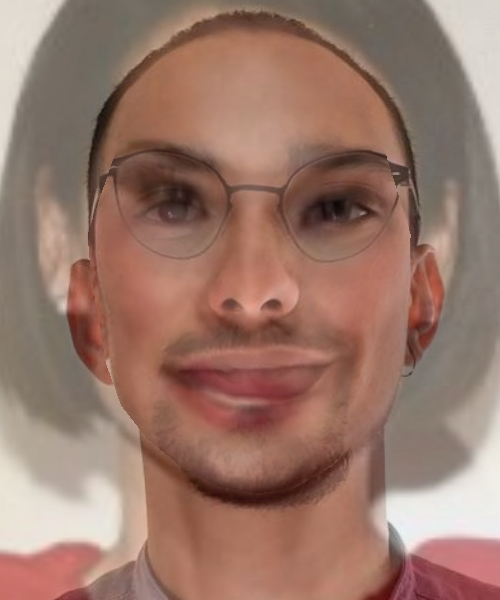

0.0411235
0.49


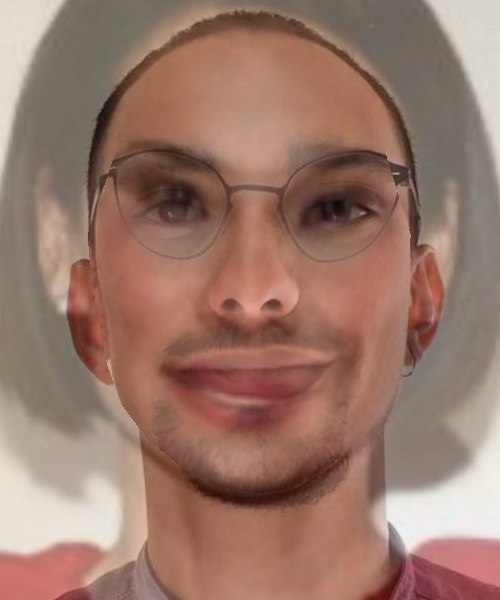

0.023259355
0.5


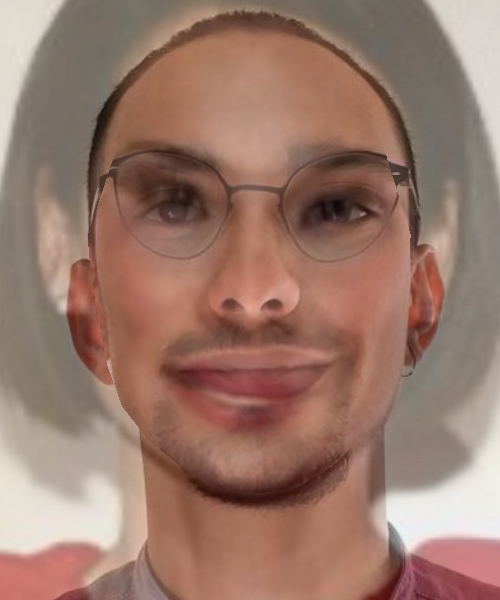

0.05251892
0.51


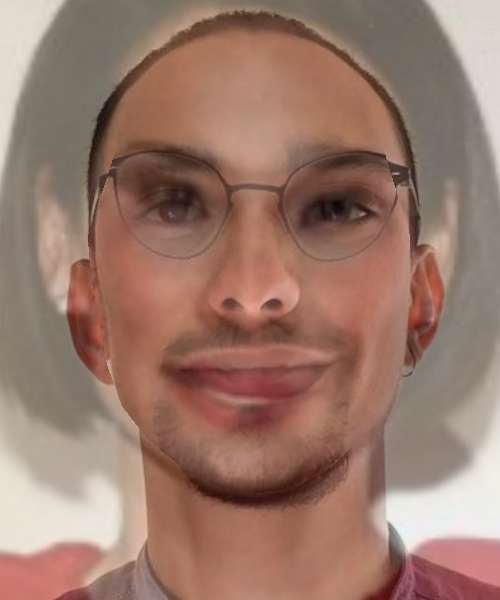

0.062231414
0.52


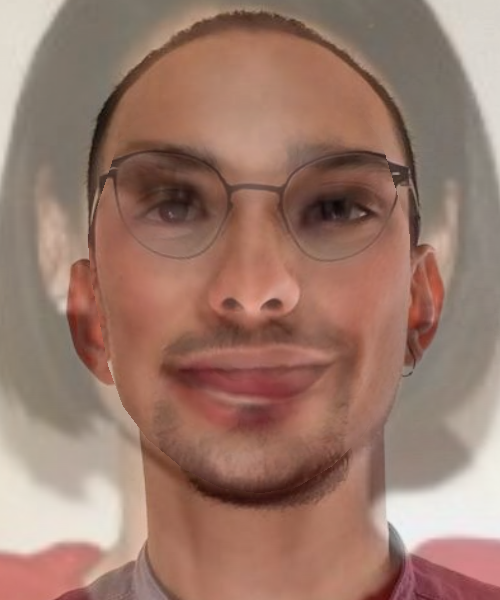

0.06572309
0.53


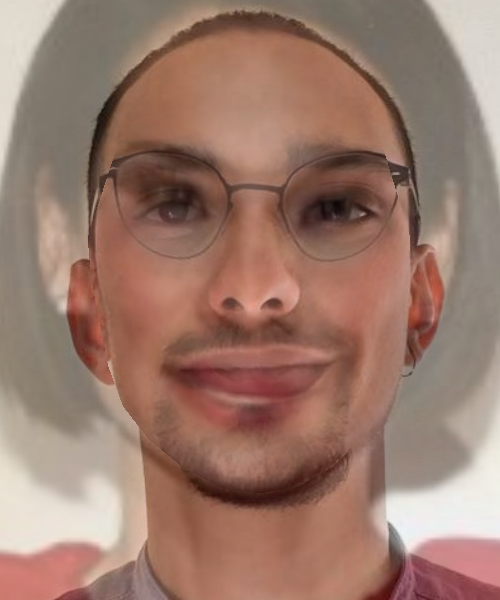

0.07318762
0.54


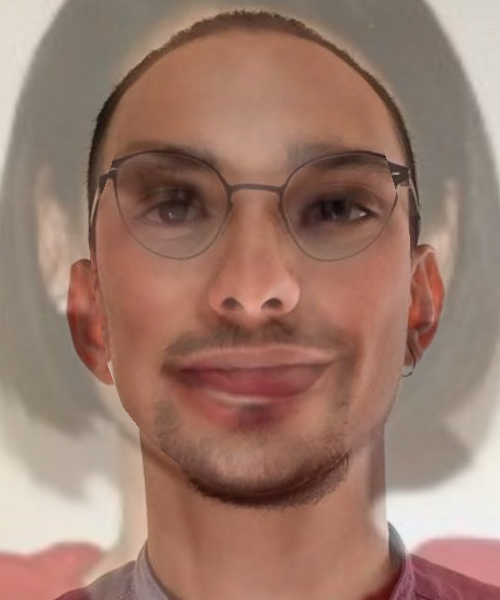

0.06842296
0.55


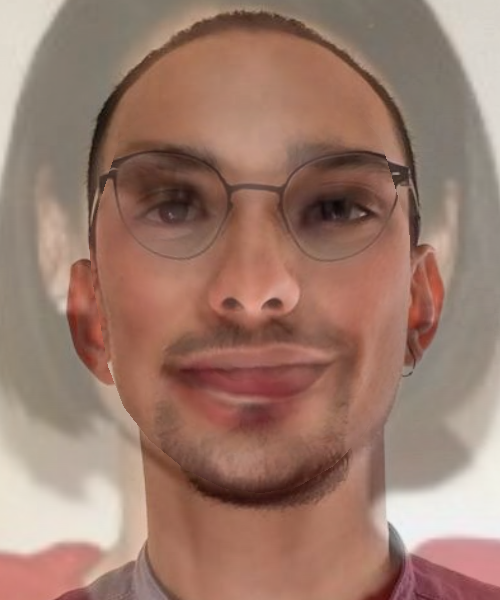

0.032763913
0.56


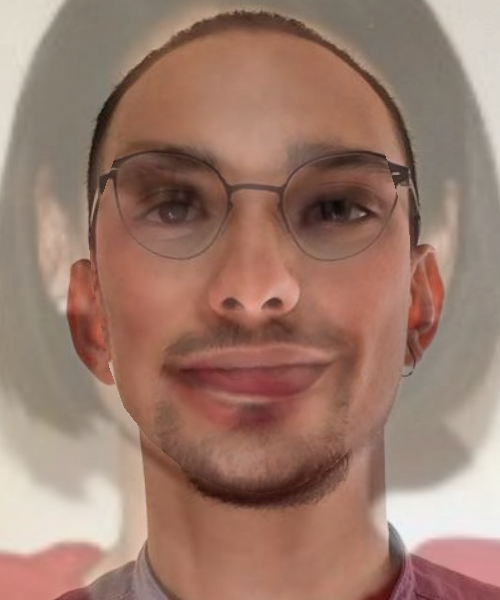

0.030699385
0.5700000000000001


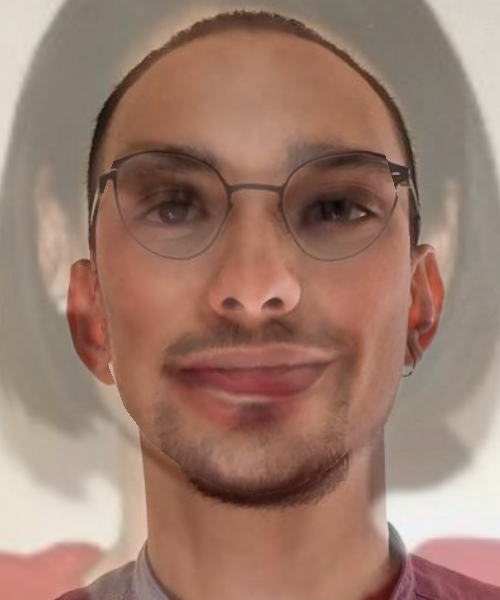

0.031025814
0.58


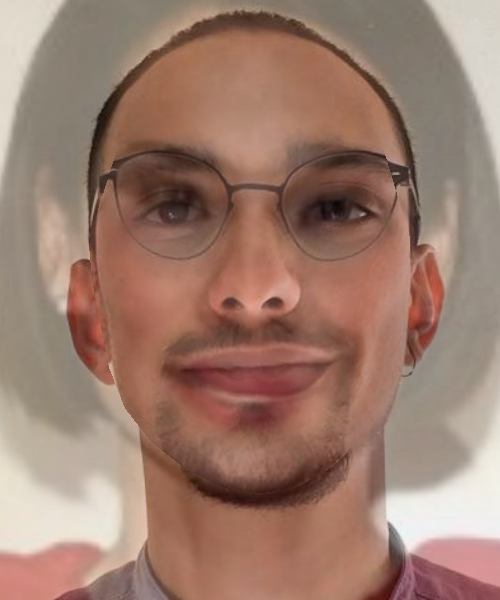

0.031610258
0.59


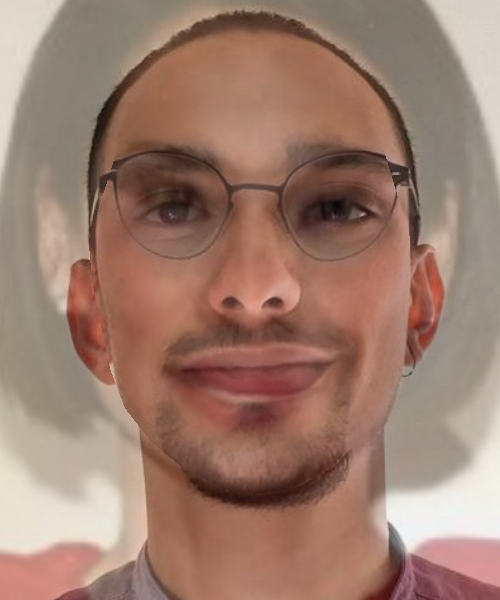

0.06142033
0.6


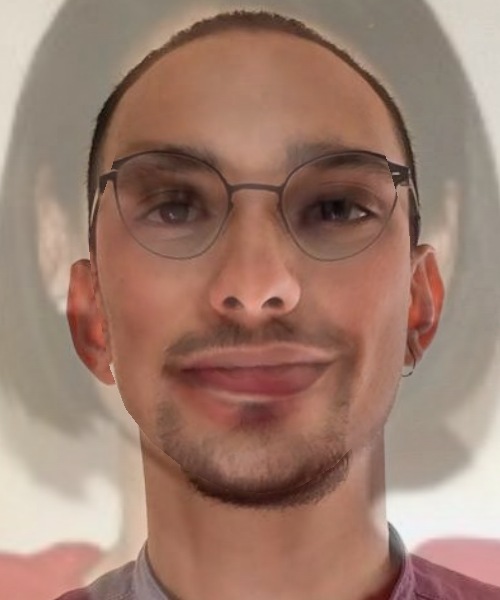

0.033205733
0.61


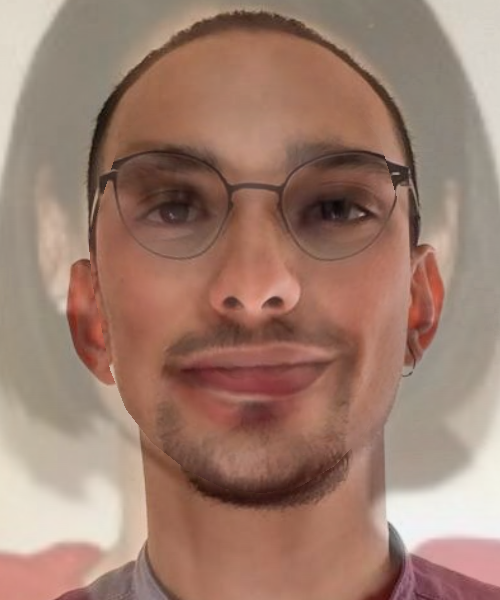

0.060922794
0.62


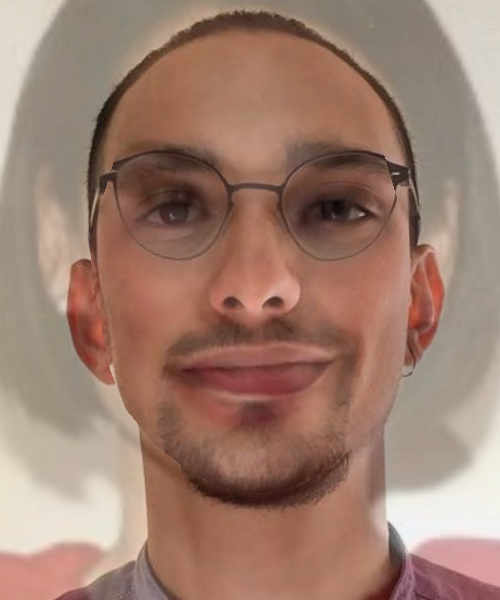

0.058221854
0.63


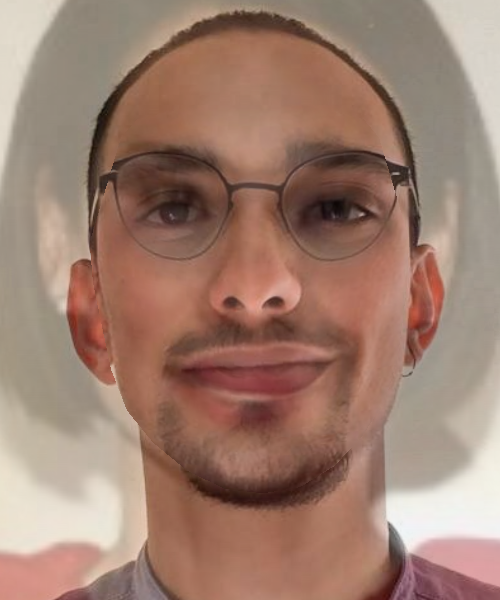

0.057842325
0.64


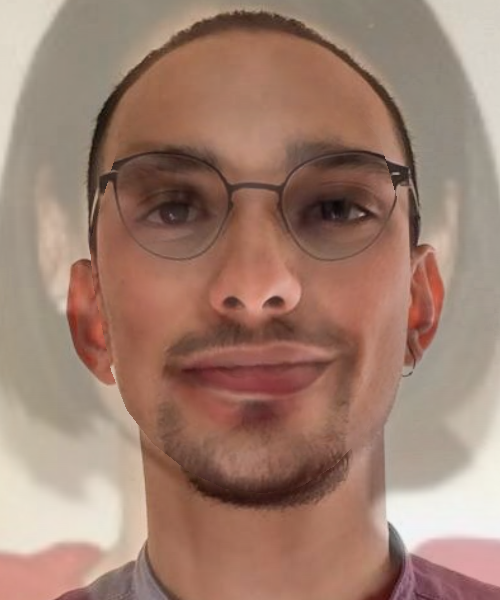

0.05779851
0.65


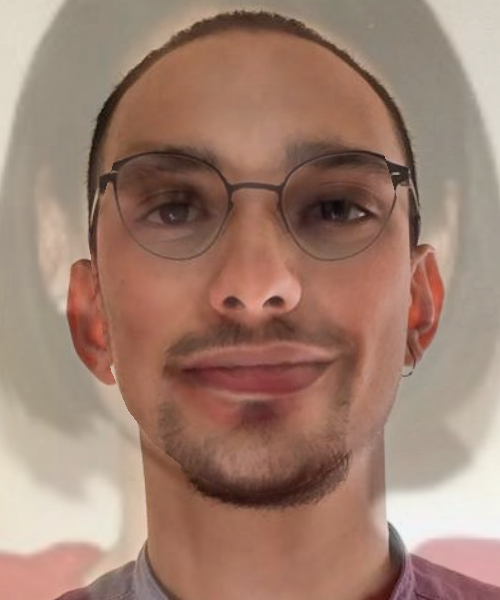

0.055164084
0.66


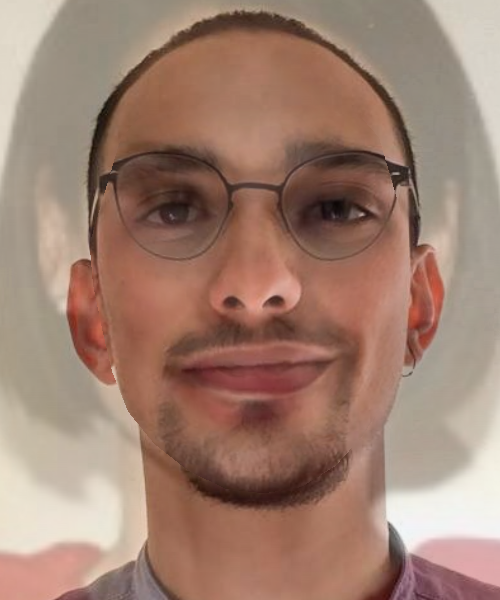

0.05460058
0.67


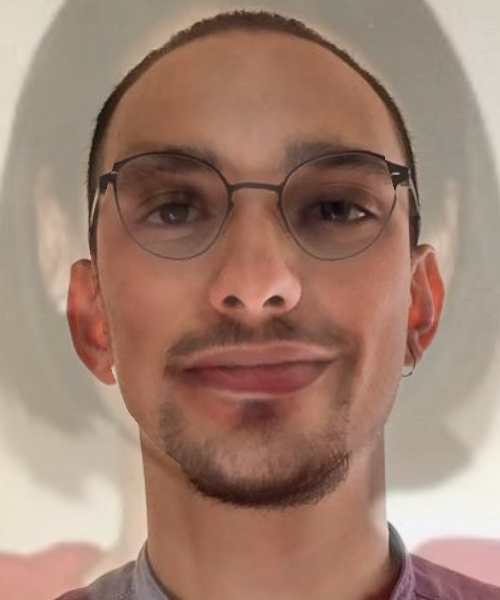

0.05574086
0.68


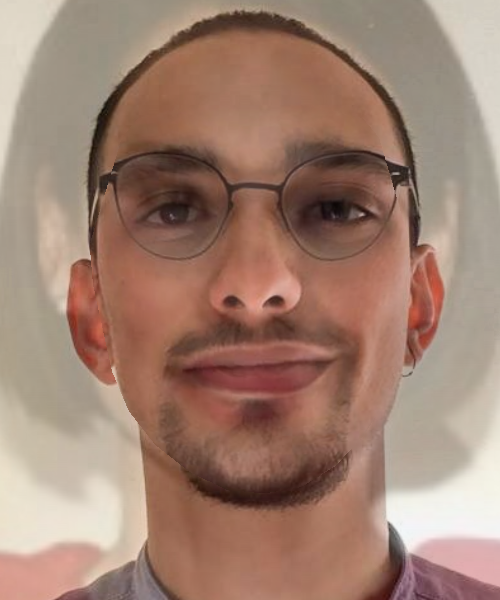

0.05753328
0.6900000000000001


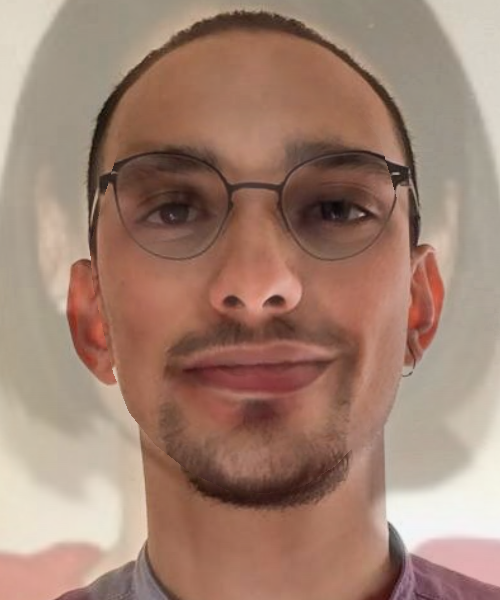

0.057266578
0.7000000000000001


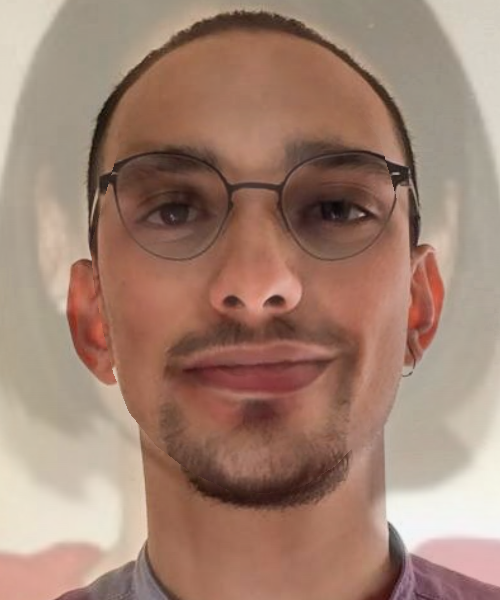

0.053044252
0.71


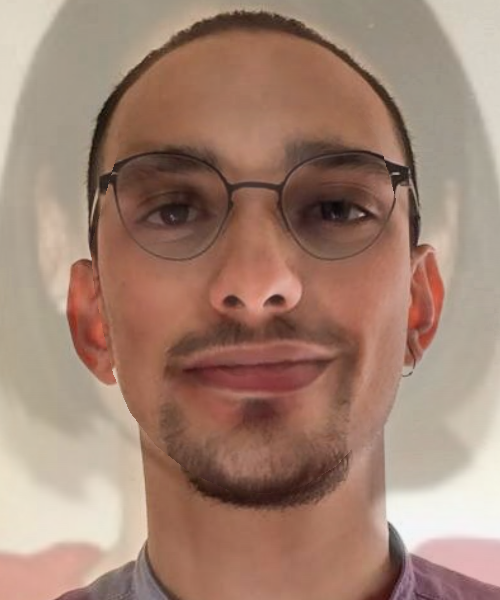

0.047168143
0.72


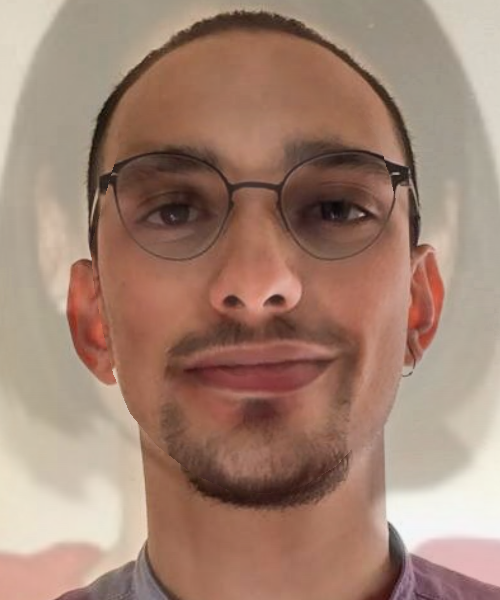

0.051569097
0.73


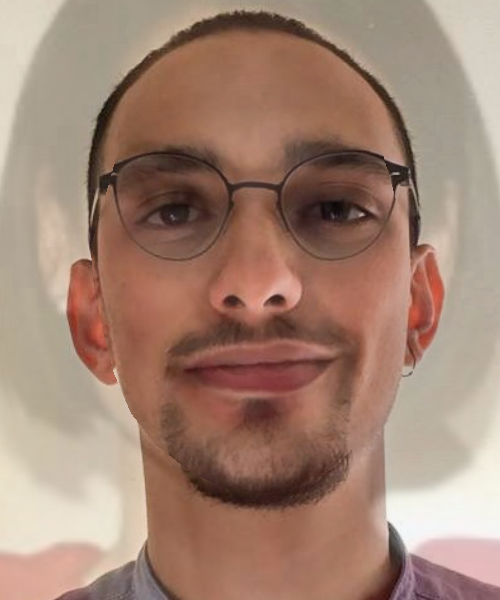

0.05119989
0.74


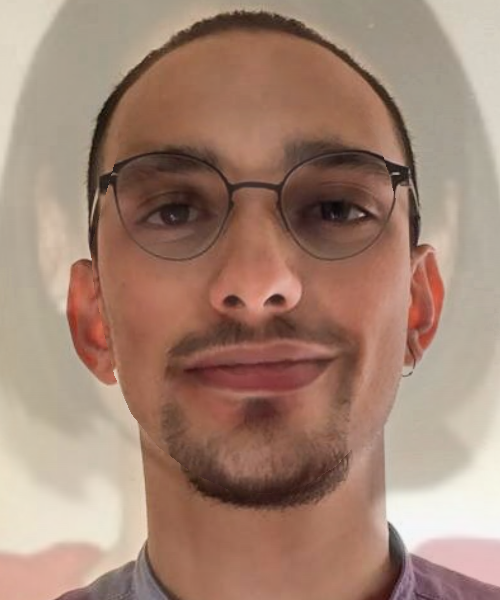

0.05616091
0.75


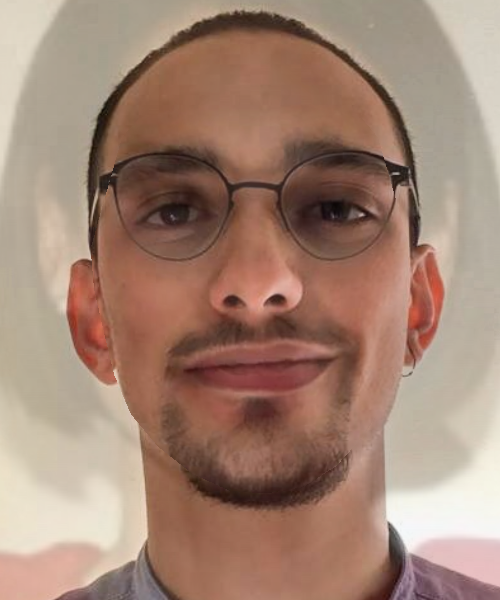

0.05471748
0.76


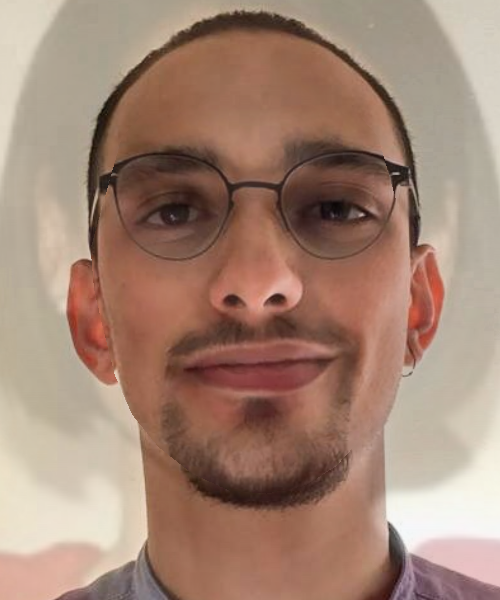

0.054275513
0.77


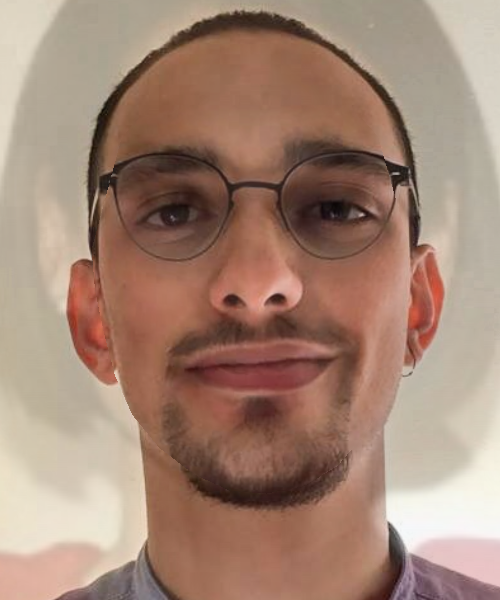

0.047606472
0.78


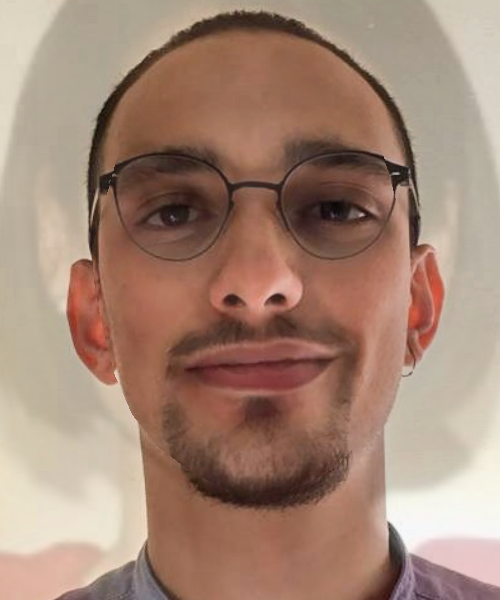

0.04388577
0.79


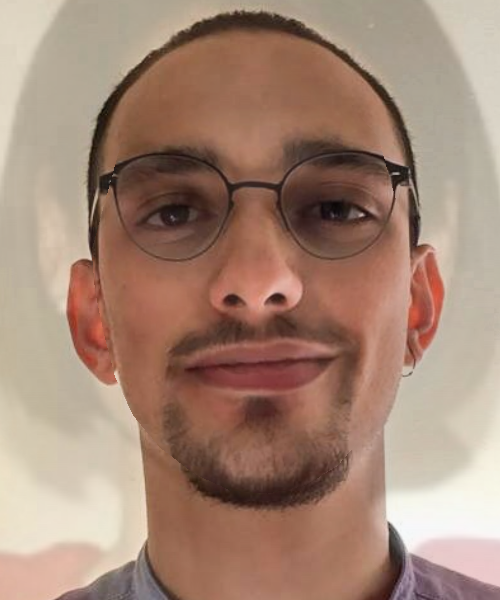

0.048398003
0.8


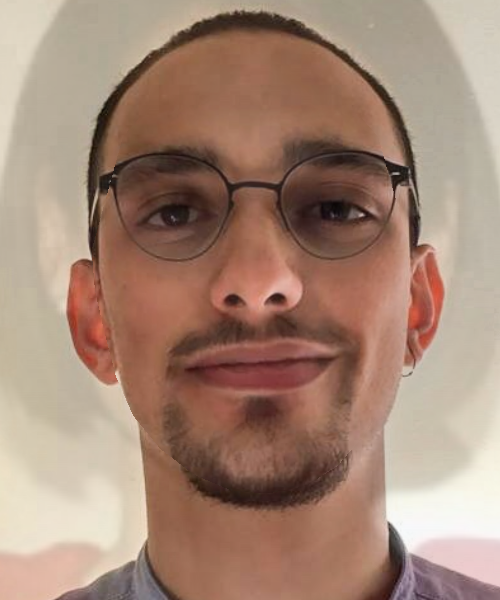

0.04689317
0.81


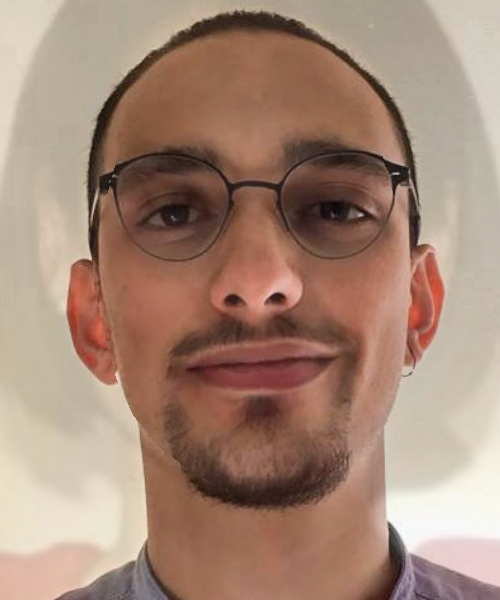

0.044192135
0.8200000000000001


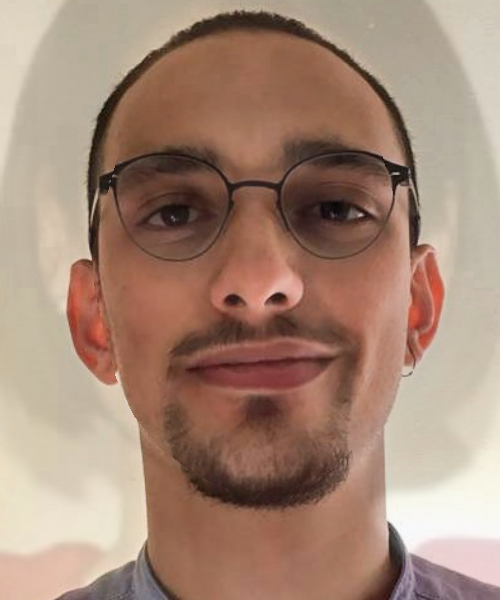

0.043058332
0.8300000000000001


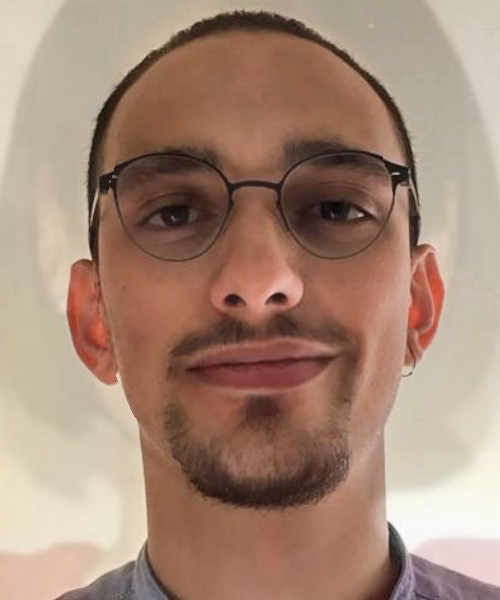

0.041516636
0.84


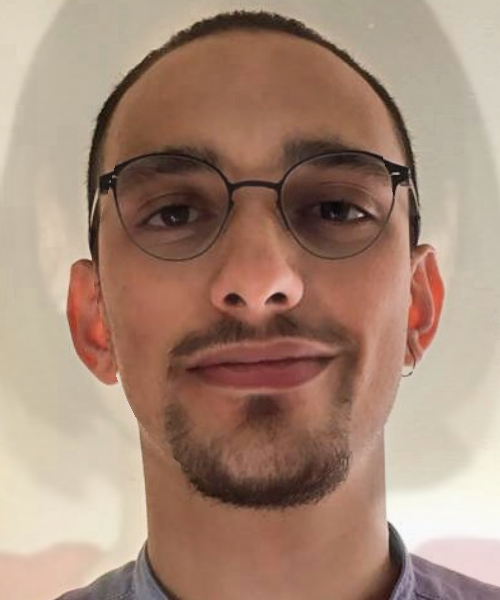

0.039986994
0.85


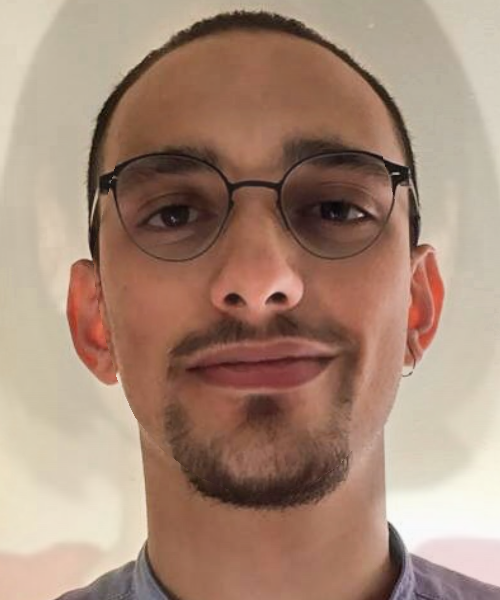

0.03922165
0.86


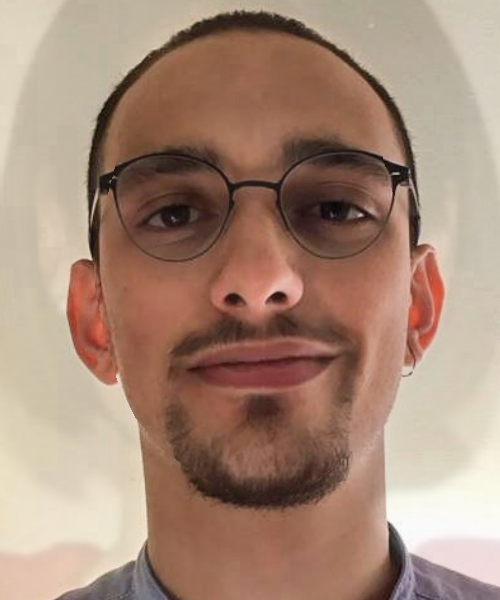

0.041964807
0.87


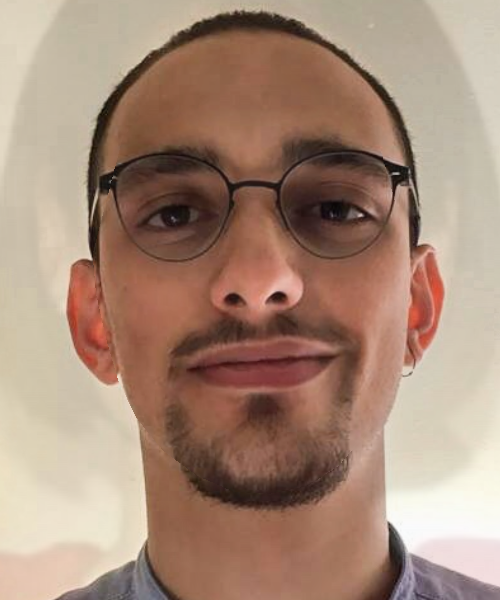

0.042639326
0.88


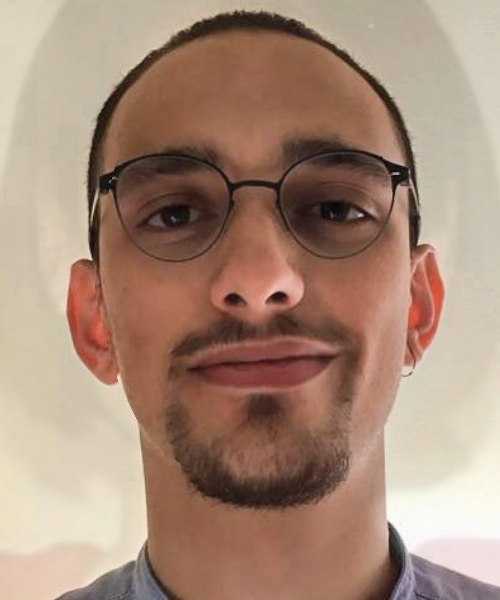

0.04042954
0.89


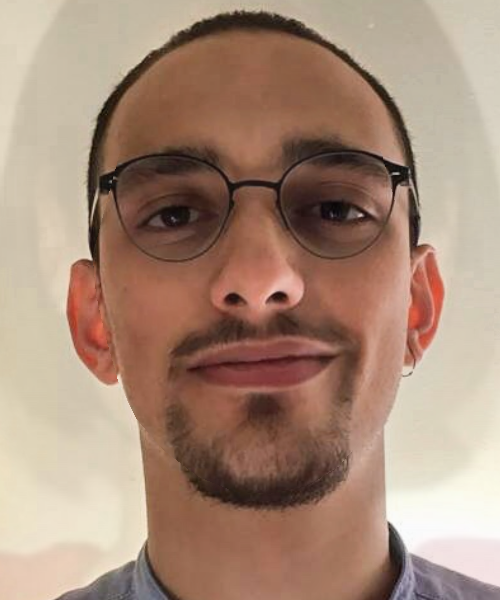

0.040807605
0.9


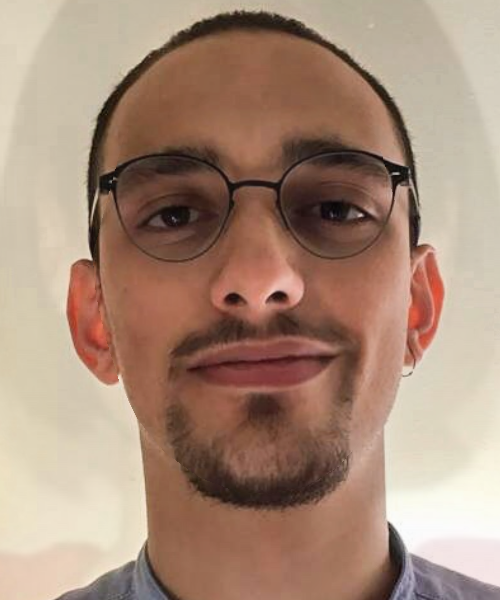

0.041193094
0.91


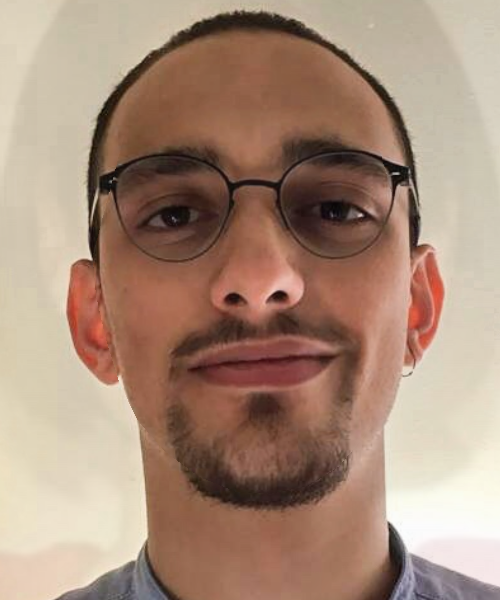

0.039226066
0.92


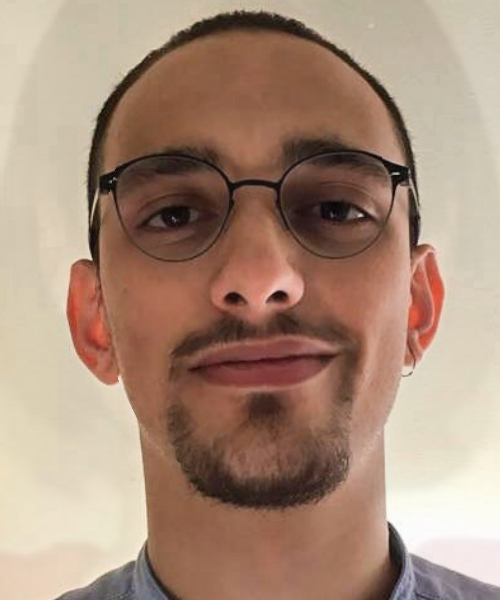

0.037438605
0.93


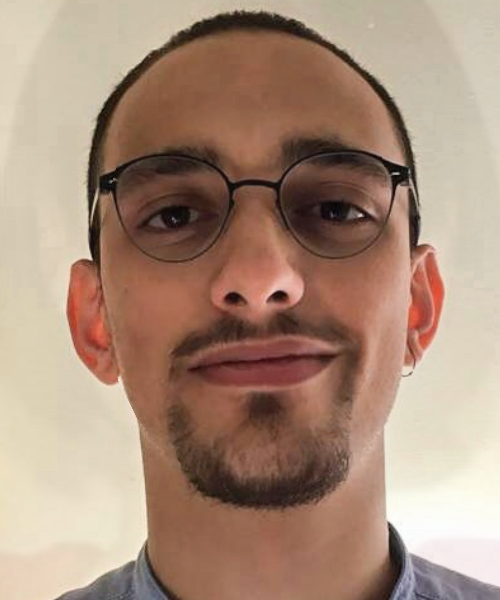

0.037907243
0.9400000000000001


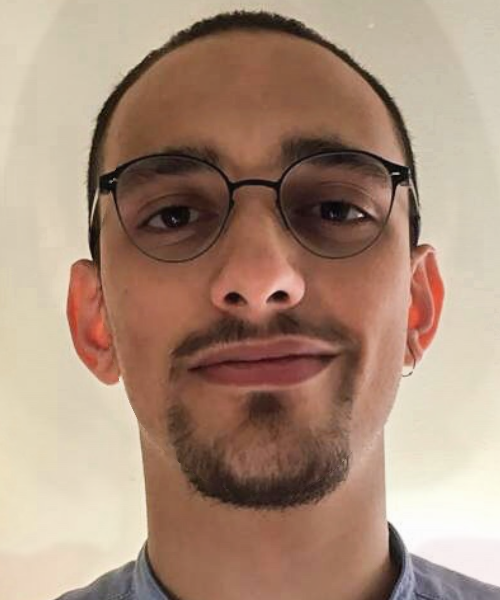

0.035084046
0.9500000000000001


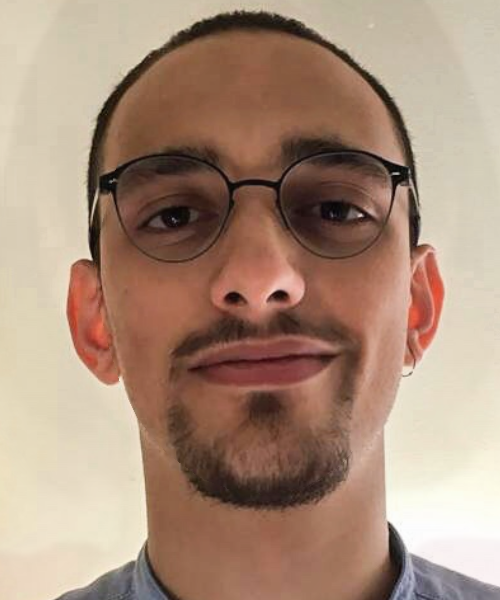

0.037056774
0.96


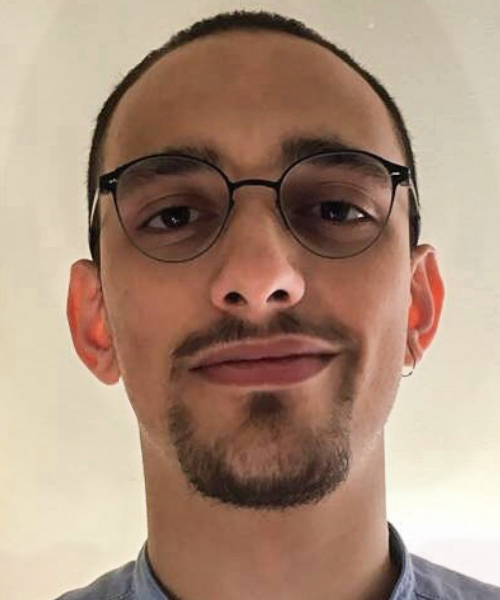

0.036799923
0.97


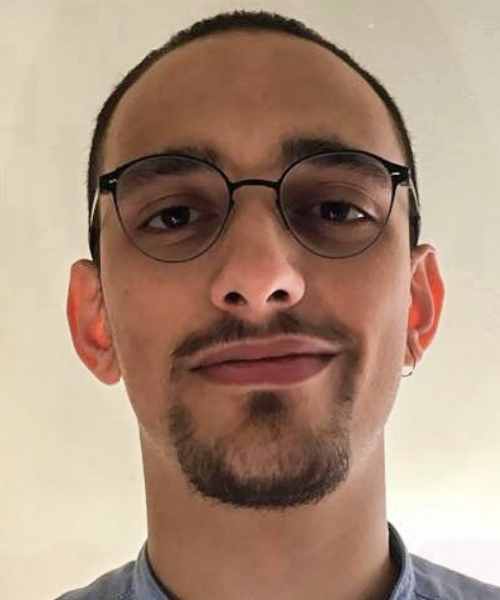

0.036585532
0.98


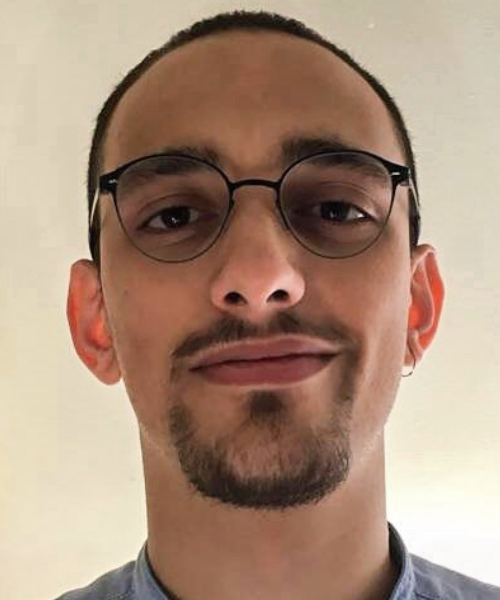

0.035664216
0.99


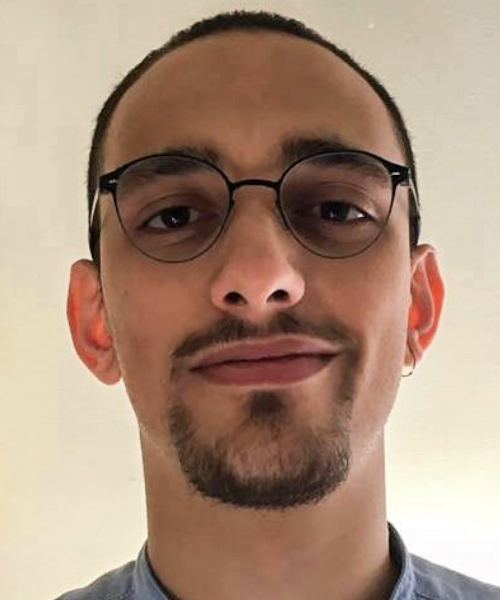

0.03504853
1.0


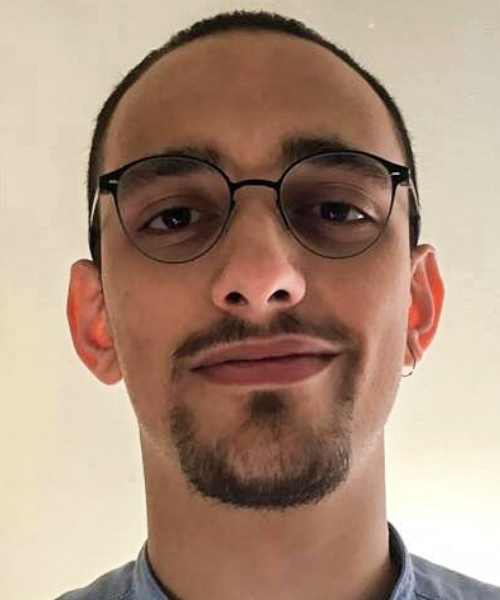

0.03667209


In [34]:
# Complete the following code:
input_image= cv2.imread('/gdrive/MyDrive/BiometricChallenge/Paolo.jpeg') #your face image
dest_image_alike=cv2.imread(test_images_path + 'liu_19.JPG') #the image of the celebrity that you look like the most
scores_morph_alike=[]
for percent in np.linspace(0, 1,101):
  #generate the morphed face accroding to the percentage
              #HERE YOUR CODE#
  print(percent)
  morph_image = morph_face(input_image, dest_image_alike, percent=percent)
  cv2_imshow(morph_image)

  #predict the similarity score to the selected celebrity
              #HERE YOUR CODE#
  predicted_scores = predict_scores(morph_image)

  #append the obtained similarity score to the list 'scores_morph_alike' 
              #HERE YOUR CODE#
  print(predicted_scores[0][19])
  scores_morph_alike.append(predicted_scores[0][19])

- Plot the similarity score for each of the (100) morphed faces, pick the morphed image that gives a similarity score that is over the threshold (defined in the previous section) and looks the most like you.

- Comment on the plot and the image selected.

- **Question:** Compare this plot to the one generated in the previous section 2.4. What do you observe?

In [35]:
#HERE YOUR CODE#
res = [ele for ele in scores_morph_alike if ele >= threshold]
print(res)

[]


**Your Answer:**

- Test the face verification function with the morphed image. What is the similarity score that you obtained?

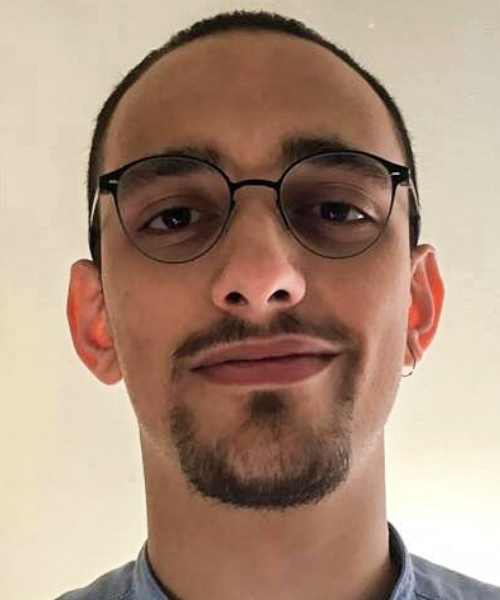

In [36]:
#HERE YOUR CODE#
input_image= cv2.imread('/gdrive/MyDrive/BiometricChallenge/Paolo.jpeg') #your face image
dest_image_alike=cv2.imread(test_images_path + 'liu_19.JPG') #the image of the celebrity that you look like the most

morphed_image_liu = morph_face(input_image, dest_image_alike, percent=0.11)
cv2_imshow(morph_image)

res = face_verification("liu", morphed_image_liu)

**Your Answer:**

### **2.6. Select the final morphing attack image that looks most like you but will grant you access to the Cannes Festival.**

Now that you know all the tricks, the time has come!

Let's see the celebrity instead of which you will be attending the Cannes Festival.

We hope that you don't face any legal charges ;)


In [ ]:
# Complete the following code:

final_morphed_face=
face_verification( , final_morphed_face)

### **2.7. (If time permits) Impact of gender and ethnicity on morphing attacks**



#### **2.7.1. Impact of gender on morphing attacks**

Choose a celebrity that doesn't have the same gender but has the same ethnicity as you.

- Generate various morphed faces (100) depending on the weight given to each of the identities (your identity, and the identity of the cross-gender/cross-ethnicity celebrity).

- Plot the morphed images at each iteration.

In [ ]:
            #HERE YOUR CODE#

- Plot the similarity score for each of the (100) morphed faces, pick the morphed image that gives a similarity score that is over the threshold (defined in the previous section) and looks the most like you.

- Comment on the plot and the image selected.

In [ ]:
            #HERE YOUR CODE#

**Your answer:**

#### **2.7.2. Impact of ethnicity on morphing attacks**

Choose a celebrity that doesn't have the same ethnicity but has the same gender as you.

- Generate various morphed faces (100) depending on the weight given to each of the identities (your identity, and the identity of the cross-gender/cross-ethnicity celebrityt).

- Plot the morphed images at each iteration.

In [ ]:
            #HERE YOUR CODE#

- Plot the similarity score for each of the (100) morphed faces, pick the morphed image that gives a similarity score that is over the threshold (defined in the previous section) and looks the most like you.

- Comment on the plot and the image selected.

In [ ]:
            #HERE YOUR CODE#

**Your answer:**

#### **2.7.3. Discussion**

Observe the plots of the similarity score in function of the weight assigned to images used to generate the morphing attack.


1.   Plot from the section 2.4
2.   Plot from the section 2.5
3.   Plot from the section 2.7.1
4. Plot from the section 2.7.2

Comment on what you observe!



**Your answer:**

## **3- Save and submit your work**
Make sure you used Save on the notebook before downloading it. You can do this either by clicking on Ctrl+S or Files-> save. Tehn download your notebook Files-> download .ipynb. Vrify that the output of the cells are saved.

If yes, send us the notebook file (.ipynb by email).

If not, double-check the settings at "Settings" -> "Site" and make sure "New notebooks use private outputs (omit outputs when saving)" is disabled. Similarly, check also "Edit" -> "Notebook settings" and make sure "Omit code cell output when saving this notebook" is disabled. And redo teh first step.
